<a href="https://colab.research.google.com/github/eguarnera/COVID-19/blob/master/covid19.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# COVID19 data

In [2]:
%pylab inline
%config InlineBackend.figure_format='retina'

import seaborn as sns
sns.set(style='darkgrid')

import pandas as pd
pd.set_option('display.max_columns', 1000)
pd.options.display.float_format = '${:,.3f}'.format


from scipy import stats as sps

Populating the interactive namespace from numpy and matplotlib


In [3]:
def crosscorr(datax, datay, lag=0, wrap=False):
    """ Lag-N cross correlation. 
    Shifted data filled with NaNs 
    
    Parameters
    ----------
    lag : int, default 0
    datax, datay : pandas.Series objects of equal length
    Returns
    ----------
    crosscorr : float
    """
    if wrap:
        shiftedy = datay.shift(lag)
        shiftedy.iloc[:lag] = datay.iloc[-lag:].values
        return datax.corr(shiftedy)
    else: 
        return datax.corr(datay.shift(lag))

# Data Italy

In [4]:
giturl_naz = 'https://raw.githubusercontent.com/pcm-dpc/COVID-19/master/dati-andamento-nazionale/dpc-covid19-ita-andamento-nazionale.csv'
giturl_reg = 'https://raw.githubusercontent.com/pcm-dpc/COVID-19/master/dati-regioni/dpc-covid19-ita-regioni.csv'
giturl_pro = 'https://raw.githubusercontent.com/pcm-dpc/COVID-19/master/dati-province/dpc-covid19-ita-province.csv'


ita=pd.read_csv(giturl_naz)
regioni=pd.read_csv(giturl_reg)
province=pd.read_csv(giturl_pro)

date=ita.data.values.astype('datetime64[D]')

In [5]:
# ita=pd.read_csv('dpc-covid19-ita-andamento-nazionale.csv')
ita['Prob decesso dopo positivo']=ita.deceduti/ita.totale_casi*100
ita['Prob positivo dopo tampone']=ita.totale_casi.diff()/ita.tamponi.diff()*100
ita['Prob intensiva dopo ospedalizzato']=ita.terapia_intensiva/ita.totale_ospedalizzati*100
ita['Prob ospedalizzato dopo positivo']=ita.totale_ospedalizzati/ita.totale_casi*100
ita['Prob decesso dopo ospedalizzato']=ita.deceduti/ita.totale_ospedalizzati*100
ita['Prob guarigione dopo ospedalizzato']=ita.dimessi_guariti/ita.totale_ospedalizzati*100
ita['Variazione [%] casi']=ita.totale_casi.diff()/ita.totale_casi.shift(periods=1)*100
ita['Variazione [%] deceduti']=ita.deceduti.diff()/ita.deceduti.shift(periods=1)*100

In [6]:
# regioni=pd.read_csv('dpc-covid19-ita-regioni.csv')
regioni['Prob decesso dopo positivo']=regioni.deceduti/regioni.totale_casi
regioni['Prob positivo dopo tampone']=regioni.totale_casi/regioni.tamponi
regioni['Prob intensiva dopo ospedalizzato']=regioni.terapia_intensiva/regioni.totale_ospedalizzati
regioni['Prob ospedalizzato dopo positivo']=regioni.totale_ospedalizzati/regioni.totale_casi
regioni['Prob decesso dopo ospedalizzato']=regioni.deceduti/regioni.totale_ospedalizzati




Text(0, 0.5, 'Correlazione')

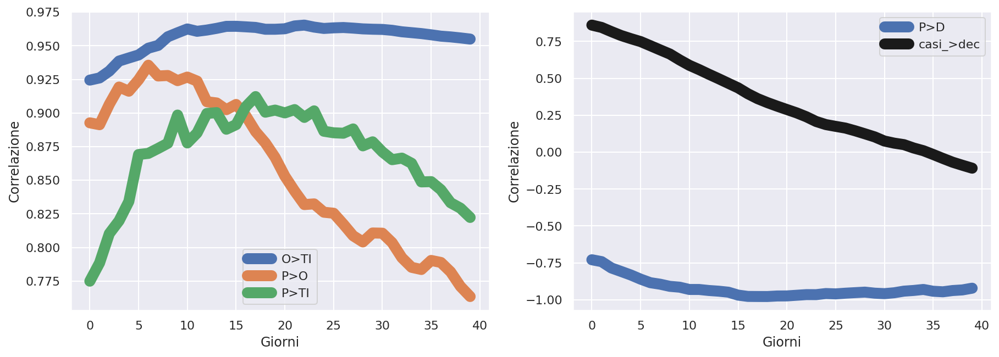

In [7]:
lag=40

figure(figsize=(15,5))
subplot(121)
plot([crosscorr(ita['Prob ospedalizzato dopo positivo'],ita['Prob intensiva dopo ospedalizzato'],lag=i) for i in range(lag)],linewidth=10,label='O>TI')
# plot([crosscorr(ita['Prob positivo dopo tampone'],ita['Prob decesso dopo positivo'],lag=i) for i in range(lag)],linewidth=10,label='P>D')
plot([crosscorr(ita['Prob positivo dopo tampone'],ita['Prob ospedalizzato dopo positivo'],lag=i) for i in range(lag)],linewidth=10,label='P>O')
plot([crosscorr(ita['Prob positivo dopo tampone'],ita['Prob intensiva dopo ospedalizzato'],lag=i) for i in range(lag)],linewidth=10,label='P>TI')
legend()
xlabel('Giorni')
ylabel('Correlazione')

subplot(122)
plot([crosscorr(ita['Prob positivo dopo tampone'],ita['Prob decesso dopo positivo'],lag=i) for i in range(lag)],linewidth=10,label='P>D')
plot([crosscorr(ita['totale_casi'].diff(),ita['deceduti'].diff(),lag=i) for i in range(lag)],'k.-',linewidth=10,label='casi_>dec')
legend()
xlabel('Giorni')
ylabel('Correlazione')



In [8]:
!pip install lmfit

     |████████████████████████████████| 266kB 2.7MB/s 
     |████████████████████████████████| 215kB 8.1MB/s 
     |████████████████████████████████| 256kB 10.8MB/s 
  Created wheel for lmfit: filename=lmfit-1.0.1-cp36-none-any.whl size=81991 sha256=da790a9154bfadd872dc6210208c8b007edc076cb68270708ca51886ce62d9c1
  Stored in directory: /root/.cache/pip/wheels/ef/22/8d/6cd9c0af36f501cfb248673b05dad5d2c27504951d55519acb
  Created wheel for asteval: filename=asteval-0.9.19-cp36-none-any.whl size=17486 sha256=7f0fbc3b3e81d25bb35f619aeedceef6ee2cabda792f64a74a844b0f6f53f173
  Stored in directory: /root/.cache/pip/wheels/59/da/bf/62853db4291f1c5f91326e32e4d1766b8cfcccd1c0e6eaf53f
Successfully built lmfit asteval


In [9]:
from lmfit.models import ExponentialModel, StepModel, LinearModel
from lmfit import Model

In [10]:
def double_exp(x, d1, d2, intercept):

    exp1 = exp(x/d1)
    exp2 = exp(-x/d2) + intercept
    return exp1 + exp2

def logistic_model(x,a,b,c,d):
    return c/(1+exp(-(x-b)/a))+d

def gompertz_model(x,a,b,c):
    return c*np.exp(-b*np.exp(-x/a))

def double_gompertz(x,a1,b1,a2,b2,c1,c2):
    return c1*np.exp(-b1*np.exp(-x/a1)) + c2*np.exp(-b2*np.exp(-x/a2))



[[Model]]
    Model(gompertz_model)
[[Fit Statistics]]
    # fitting method   = leastsq
    # function evals   = 75
    # data points      = 227
    # variables        = 3
    chi-square         = 31533323.6
    reduced chi-square = 140773.766
    Akaike info crit   = 2694.04443
    Bayesian info crit = 2704.31928
[[Variables]]
    a:  18.8532029 +/- 0.12853604 (0.68%) (init = 1)
    b:  7.45286771 +/- 0.11591896 (1.56%) (init = 5)
    c:  35292.3196 +/- 34.7381049 (0.10%) (init = 10000)
[[Correlations]] (unreported correlations are < 0.100)
    C(a, b) = -0.942
    C(a, c) =  0.447
    C(b, c) = -0.320


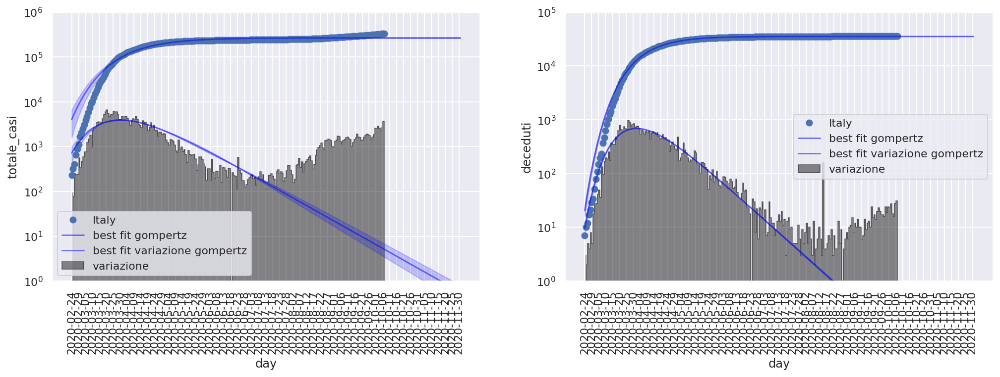

In [11]:
drange=pd.date_range(start="2020-02-24",end="2020-12-01")
drange=array(drange.format(formatter=lambda x: x.strftime('%Y-%m-%d')))
LL=len(drange)



skip=5
var='totale_casi'

par=len(ita[var])+1
# par=30

yy=ita[var][:par]

xx=arange(len(yy))
xp=arange(LL)

model1 = StepModel(form='logistic')
params1 = model1.guess(yy, x=xx)

model2 = Model(gompertz_model)
params2 = model2.make_params(a=1, b=5, c=10000)

# model2 = Model(double_gompertz)
# params2 = model2.make_params(a1=10, b1=5, a2=100, b2=50, c1=1000000, c2=1000000)


figure(figsize=(17,5))

subplot(121)

result1 = model1.fit(yy, params1, x=xx)
result2 = model2.fit(yy, params2, x=xx)

dely1 = result1.eval_uncertainty(x=xp,sigma=2)
dely2 = result2.eval_uncertainty(x=xp,sigma=2)

# subplot(121)
plot(xx,yy,'bo',label='Italy')

# fill_between(xp, (result1.eval(x=xp)-dely1), (result1.eval(x=xp)+dely1), color="red",alpha=0.2)
fill_between(xp, (result2.eval(x=xp)-dely2), (result2.eval(x=xp)+dely2), color="blue",alpha=0.2)

# plot((result1.eval(x=xp)),label='best fit logistic', color="red",alpha=0.5)
plot((result2.eval(x=xp)),label='best fit gompertz', color="blue",alpha=0.5)


gca().set_xticks(xp[::4]);
gca().set_xticklabels(ita.data[arange(0,len(ita.data),skip)]);
gca().set_xticklabels(xp[::4]);
# gca().get_yaxis().set_major_formatter(matplotlib.ticker.ScalarFormatter())
xticks(rotation=90);
xlabel('day')
# ylim([100,100000])
legend()

# subplot(122)
fill_between(xx,yy.diff(),label='variazione',alpha=0.5,step="pre",color='k')

# fill_between(xp[:-1], diff(result1.eval(x=xp)-dely1), diff(result1.eval(x=xp)+dely1), color="red",alpha=0.2)
fill_between(xp[:-1], diff(result2.eval(x=xp)-dely2), diff(result2.eval(x=xp)+dely2), color="blue",alpha=0.2)
# plot(diff(result1.eval(x=xp)),label='best fit variazione logistic', color="red",alpha=0.5)
plot(diff(result2.eval(x=xp)),label='best fit variazione gompertz', color="blue",alpha=0.5)


yscale('log')

skip=5
gca().set_xticks(xp[::skip]);
gca().set_xticklabels(drange[::skip]);
# gca().set_xticklabels(xp);
# gca().get_yaxis().set_major_formatter(matplotlib.ticker.ScalarFormatter())
xticks(rotation=90);
xlabel('day')
ylabel(var)
gca().set_ylim(bottom=1,top=10**6)


# ylim([0,1000])
legend()
#################################

var='deceduti'

yy=ita[var][:par]
xx=arange(len(yy))
xp=arange(LL)

model1 = StepModel(form='logistic')
params1 = model1.guess(yy, x=xx)

model2 = Model(gompertz_model)
params2 = model2.make_params(a=1, b=5, c=10000)



# figure(figsize=(17,5))
result1 = model1.fit(yy, params1, x=xx)
result2 = model2.fit(yy, params2, x=xx)

dely1 = result1.eval_uncertainty(x=xp,sigma=2)
dely2 = result2.eval_uncertainty(x=xp,sigma=2)

subplot(122)
plot(xx,yy,'bo',label='Italy')

# fill_between(xp, (result1.eval(x=xp)-dely1), (result1.eval(x=xp)+dely1), color="red",alpha=0.2)
fill_between(xp, (result2.eval(x=xp)-dely2), (result2.eval(x=xp)+dely2), color="blue",alpha=0.2)

# plot((result1.eval(x=xp)),label='best fit logistic', color="red",alpha=0.5)
plot((result2.eval(x=xp)),label='best fit gompertz', color="blue",alpha=0.5)


gca().set_xticks(xp[::4]);
gca().set_xticklabels(ita.data[arange(0,len(ita.data),skip)]);
gca().set_xticklabels(xp[::4]);
# gca().get_yaxis().set_major_formatter(matplotlib.ticker.ScalarFormatter())
xticks(rotation=90);
xlabel('day')
# ylim([100,100000])
legend()

# subplot(122)
fill_between(xx,yy.diff(),label='variazione',alpha=0.5,step="pre",color='k')

# fill_between(xp[:-1], diff(result1.eval(x=xp)-dely1), diff(result1.eval(x=xp)+dely1), color="red",alpha=0.2)
fill_between(xp[:-1], diff(result2.eval(x=xp)-dely2), diff(result2.eval(x=xp)+dely2), color="blue",alpha=0.2)
# plot(diff(result1.eval(x=xp)),label='best fit variazione logistic', color="red",alpha=0.5)
plot(diff(result2.eval(x=xp)),label='best fit variazione gompertz', color="blue",alpha=0.5)


yscale('log')

skip=5
gca().set_xticks(xp[::skip]);
gca().set_xticklabels(drange[::skip]);
# gca().set_xticklabels(xp);
# gca().get_yaxis().set_major_formatter(matplotlib.ticker.ScalarFormatter())
xticks(rotation=90);
xlabel('day')
ylabel(var)
gca().set_ylim(bottom=1,top=10**5)


# ylim([0,1000])
legend()

print(result2.fit_report())


Text(0, 0.5, 'daily Deaths')

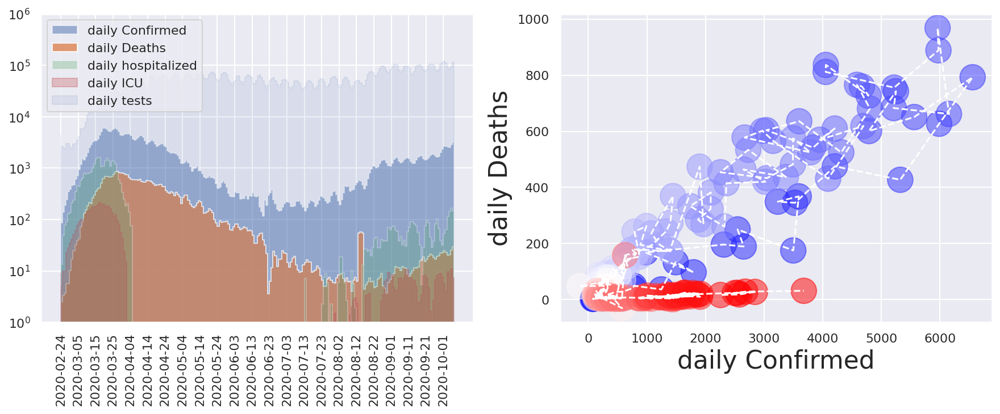

In [12]:
rr='Lazio'


figure(figsize=(15,5))

subplot(121)

yy=ita
# yy=regioni[regioni.denominazione_regione==rr]

# plot(yy.Date,yy.Confirmed,label='Confirmed',linewidth=3)
fill_between(yy.data,yy.totale_casi.diff().rolling(3,
    win_type='gaussian',
    min_periods=1,
    center=True).mean(std=3),alpha=0.5,step="pre",label='daily Confirmed')

# plot(yy.Date,yy.Deaths,label='Deaths',linewidth=3)
# plot(yy.data,yy.deceduti.diff().rolling(3,
#     win_type='gaussian',
#     min_periods=1,
#     center=True).mean(std=3),'k-')
fill_between(yy.data,yy.deceduti.diff().rolling(3,
    win_type='gaussian',
    min_periods=1,
    center=True).mean(std=3),alpha=0.8,step="pre",label='daily Deaths')

fill_between(yy.data,yy.ricoverati_con_sintomi.diff().rolling(3,
    win_type='gaussian',
    min_periods=1,
    center=True).mean(std=3),alpha=0.3,step="pre",label='daily hospitalized')

fill_between(yy.data,yy.terapia_intensiva.diff().rolling(3,
    win_type='gaussian',
    min_periods=1,
    center=True).mean(std=3),alpha=0.3,step="pre",label='daily ICU',color='r')

fill_between(yy.data,yy.tamponi.diff().rolling(3,
    win_type='gaussian',
    min_periods=1,
    center=True).mean(std=3),alpha=0.1,step="pre",label='daily tests',color='b')

# title(ss)
xticks(rotation=90)
yscale('log')
gca().set_ylim(bottom=1,top=1000000)
skip=10
gca().set_xticks(range(len(yy))[::skip]);
gca().set_xticklabels(date[::skip]);
legend(loc=2)


subplot(122)
plot(yy.totale_casi.diff(),yy.deceduti.diff(),'w--')

scatter(yy.totale_casi.diff(),yy.deceduti.diff(),c=range(len(yy.deceduti.diff())), cmap='bwr',s=500,alpha=0.5)
# scatter(range(1000,2000),800*ones(1000),c=range(1000), cmap='bwr',s=100,alpha=0.5)

xlabel('daily Confirmed',fontsize=22)
ylabel('daily Deaths',fontsize=22)
# gca().set_xlim(left=0)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:47: UserWarning: Attempted to set non-positive bottom ylim on a log-scaled axis.
Invalid limit will be ignored.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:47: UserWarning: Attempted to set non-positive bottom ylim on a log-scaled axis.
Invalid limit will be ignored.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:47: UserWarning: Attempted to set non-positive bottom ylim on a log-scaled axis.
Invalid limit will be ignored.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:47: UserWarning: Attempted to set non-positive bottom ylim on a log-scaled axis.
Invalid limit will be ignored.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:47: UserWarning: Attempted to set non-positive bottom ylim on a log-scaled axis.
Invalid limit will be ignored.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:47: UserWarning: Attempted to set non-positive bottom ylim on a log-scaled

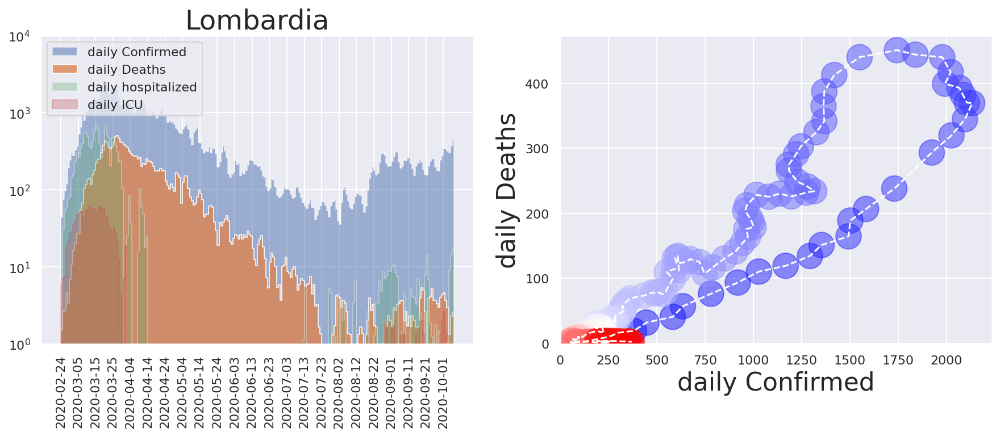

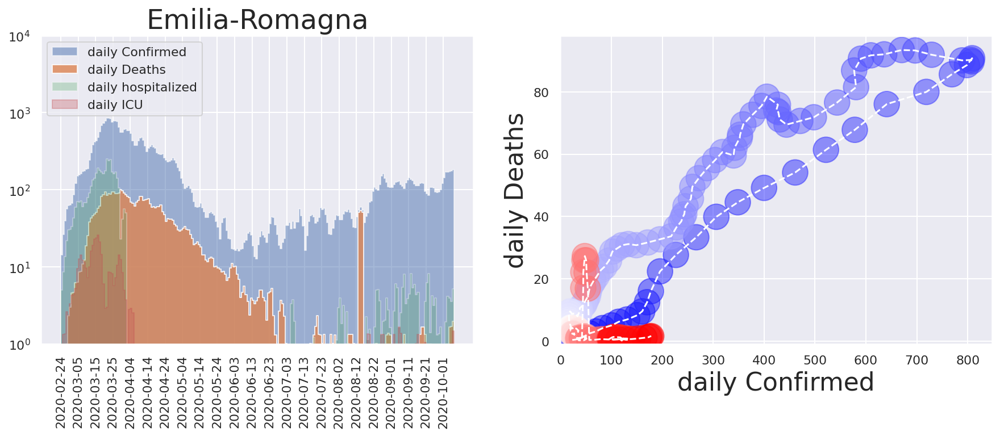

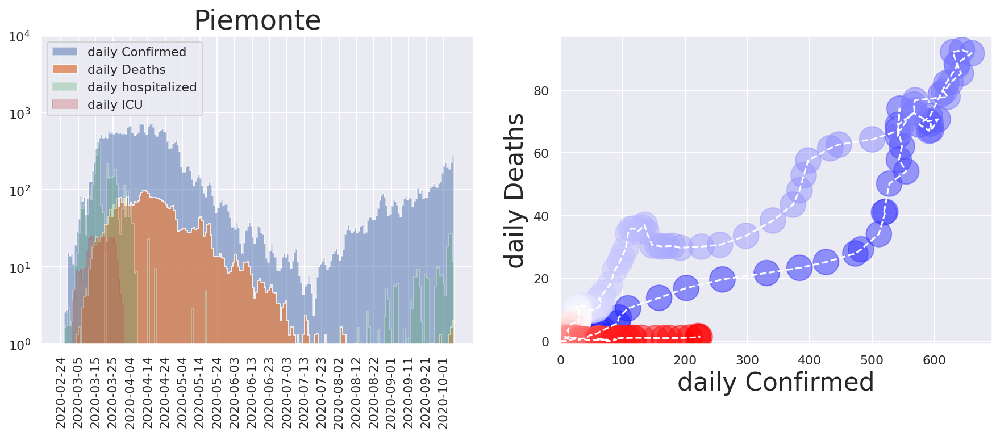

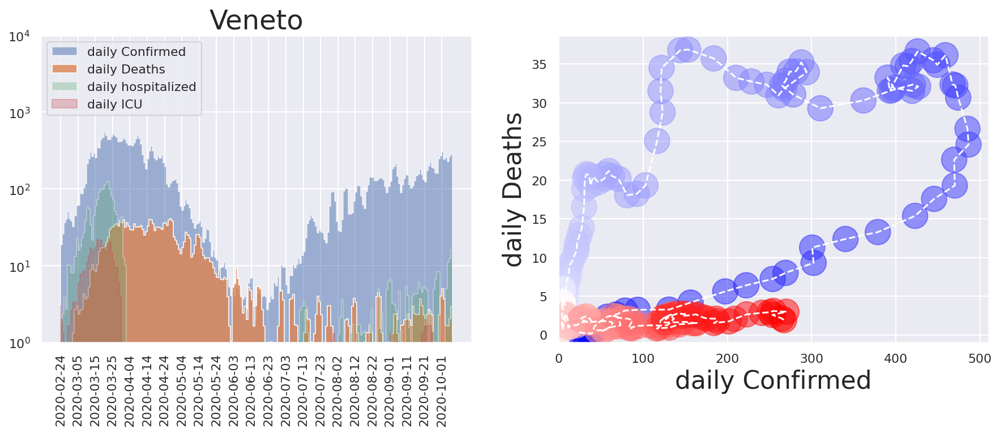

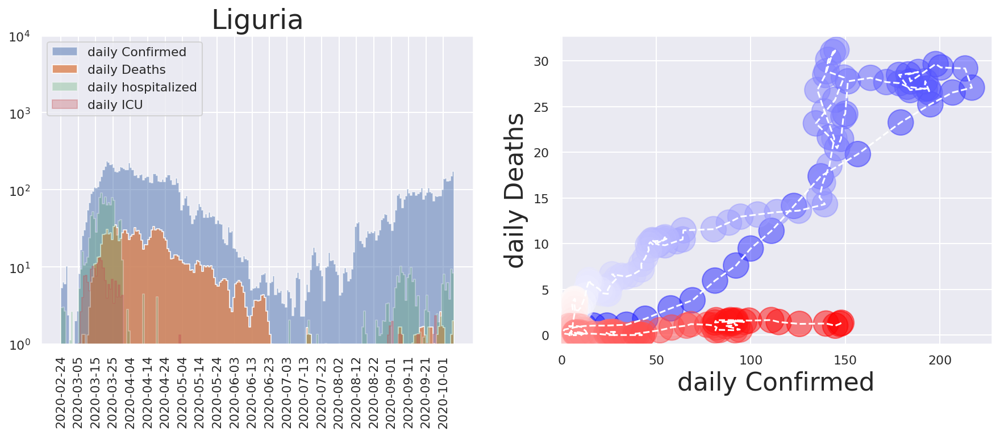

...

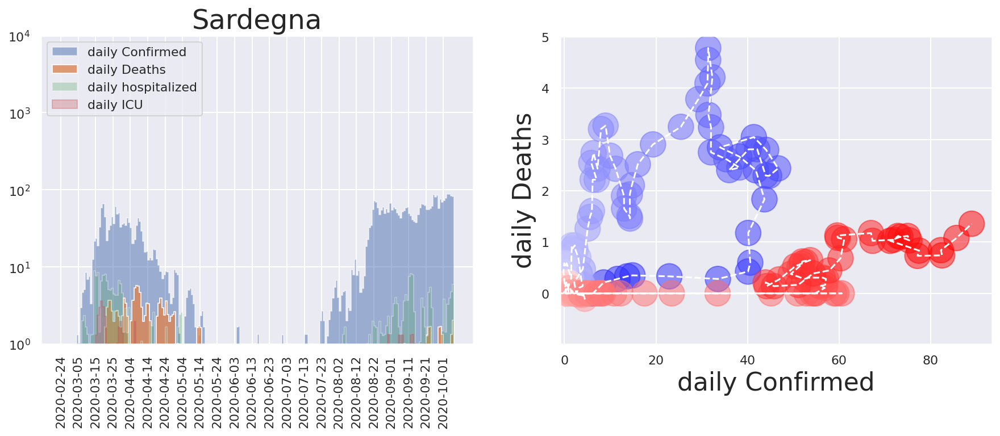

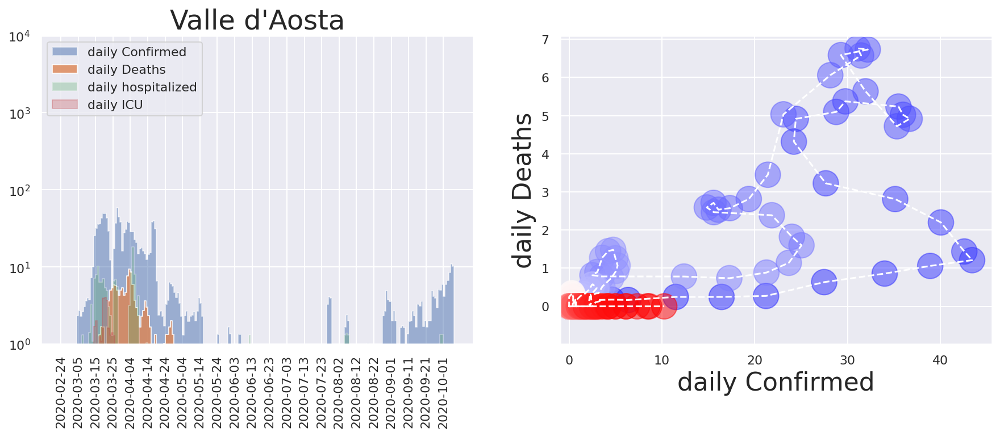

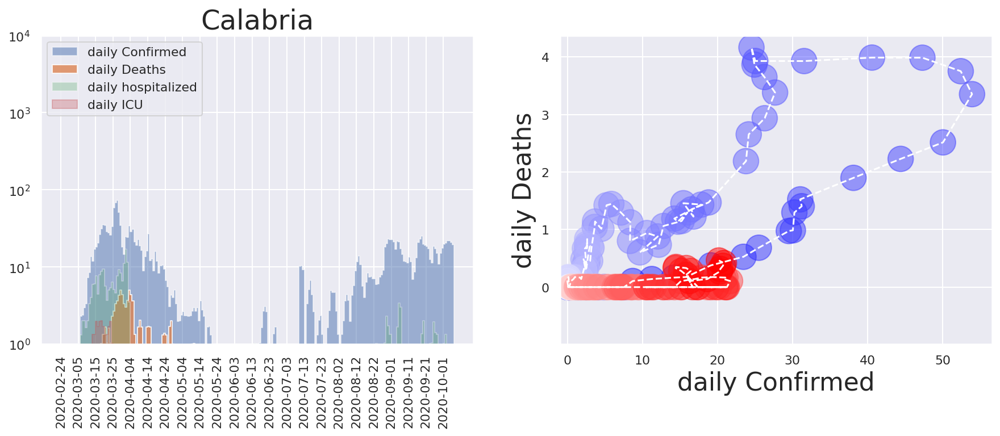

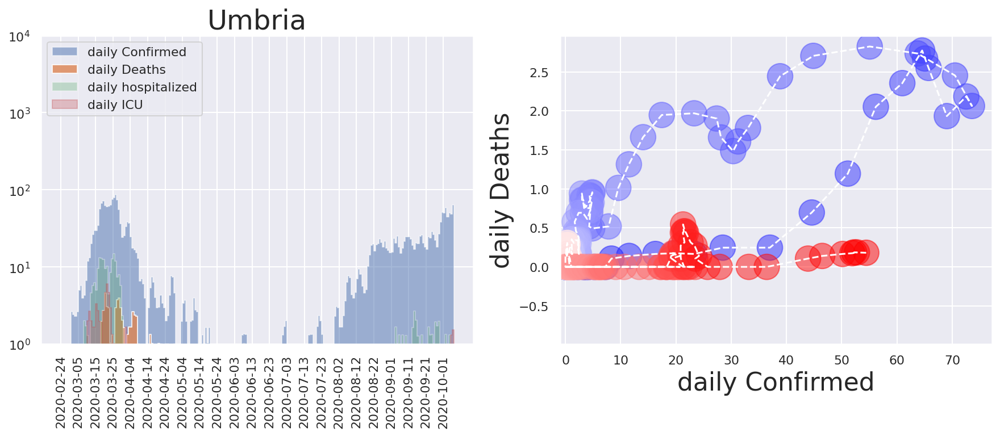

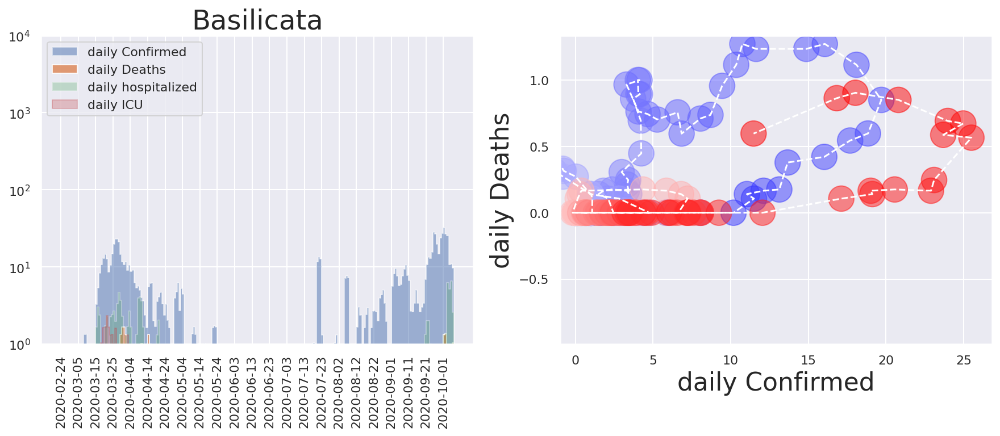

In [13]:
reglist=regioni.sort_values(by=['deceduti','denominazione_regione'],ascending=False).denominazione_regione.unique()

for reg in reglist[:20]:
    
    figure(figsize=(15,5))

    subplot(121)
    
    title(reg,fontsize=24)
    yy=regioni[regioni.denominazione_regione==reg]

    # plot(yy.Date,yy.Confirmed,label='Confirmed',linewidth=3)
    fill_between(yy.data,yy.totale_casi.diff().rolling(3,
        win_type='gaussian',
        min_periods=1,
        center=True).mean(std=3),alpha=0.5,step="pre",label='daily Confirmed')

    # plot(yy.Date,yy.Deaths,label='Deaths',linewidth=3)
    # plot(yy.data,yy.deceduti.diff().rolling(3,
    #     win_type='gaussian',
    #     min_periods=1,
    #     center=True).mean(std=3),'k-')
    fill_between(yy.data,yy.deceduti.diff().rolling(3,
        win_type='gaussian',
        min_periods=1,
        center=True).mean(std=3),alpha=0.8,step="pre",label='daily Deaths')

    fill_between(yy.data,yy.ricoverati_con_sintomi.diff().rolling(3,
        win_type='gaussian',
        min_periods=1,
        center=True).mean(std=3),alpha=0.3,step="pre",label='daily hospitalized')

    fill_between(yy.data,yy.terapia_intensiva.diff().rolling(3,
        win_type='gaussian',
        min_periods=1,
        center=True).mean(std=3),alpha=0.3,step="pre",label='daily ICU',color='r')

#     fill_between(yy.data,yy.tamponi.diff().rolling(3,
#         win_type='gaussian',
#         min_periods=1,
#         center=True).mean(std=3),alpha=0.1,step="pre",label='daily tests',color='b')

    # title(ss)
    xticks(rotation=90)
    yscale('log')
    gca().set_ylim(bottom=1,top=10000)
    gca().set_ylim(bottom=0)
    skip=10
    gca().set_xticks(range(len(yy))[::skip]);
    gca().set_xticklabels(date[::skip]);
    legend(loc=2)

    rol=7
    sstd=3
    subplot(122)
    plot(yy.totale_casi.diff().rolling(rol,
        win_type='gaussian',
        min_periods=1,
        center=True).mean(std=sstd),yy.deceduti.diff().rolling(rol,
        win_type='gaussian',
        min_periods=1,
        center=True).mean(std=sstd),'w--')

    scatter(yy.totale_casi.diff().rolling(rol,
        win_type='gaussian',
        min_periods=1,
        center=True).mean(std=sstd),yy.deceduti.diff().rolling(rol,
        win_type='gaussian',
        min_periods=1,
        center=True).mean(std=sstd),c=range(len(yy.deceduti.diff())), cmap='bwr',s=500,alpha=0.5)
    # scatter(range(1000,2000),800*ones(1000),c=range(1000), cmap='bwr',s=100,alpha=0.5)

    xlabel('daily Confirmed',fontsize=22)
    ylabel('daily Deaths',fontsize=22)
    gca().set_xlim(left=-0.99)
    gca().set_ylim(bottom=-0.99)



In [14]:
regg=regioni.sort_values(by=['totale_casi','denominazione_regione'],ascending=False).denominazione_regione.unique()

regg_1={}

for rr in regg:
    regg_1[rr+'C']=array(regioni[regioni['denominazione_regione']==rr].totale_casi.diff())
    regg_1[rr+'D']=array(regioni[regioni['denominazione_regione']==rr].deceduti.diff())

regg_1_df=pd.DataFrame(regg_1)

regg_1_df.corr().style.background_gradient(cmap='BuPu')

,LombardiaC,LombardiaD,PiemonteC,PiemonteD,Emilia-RomagnaC,Emilia-RomagnaD,VenetoC,VenetoD,LazioC,LazioD,ToscanaC,ToscanaD,CampaniaC,CampaniaD,LiguriaC,LiguriaD,PugliaC,PugliaD,MarcheC,MarcheD,SiciliaC,SiciliaD,P.A. TrentoC,P.A. TrentoD,Friuli Venezia GiuliaC,Friuli Venezia GiuliaD,AbruzzoC,AbruzzoD,SardegnaC,SardegnaD,P.A. BolzanoC,P.A. BolzanoD,UmbriaC,UmbriaD,CalabriaC,CalabriaD,Valle d'AostaC,Valle d'AostaD,BasilicataC,BasilicataD,MoliseC,MoliseD
LombardiaC,1.000000,0.889675,0.772194,0.645640,0.909994,0.827402,0.807747,0.654789,0.374290,0.461314,0.722484,0.696408,0.140159,0.642751,0.737025,0.775538,0.541524,0.571630,0.880830,0.784876,0.304059,0.639025,0.606597,0.544782,0.750945,0.697479,0.727893,0.539043,0.205040,0.460037,0.729537,0.559429,0.607175,0.548506,0.594038,0.560897,0.714367,0.621203,0.289541,0.333870,0.376935,0.510986
LombardiaD,0.889675,1.000000,0.819574,0.754691,0.891781,0.875349,0.779636,0.750685,0.343557,0.538513,0.717632,0.755807,0.081022,0.758434,0.732234,0.847301,0.530104,0.655503,0.823067,0.865050,0.258674,0.745006,0.628609,0.631387,0.705270,0.761809,0.711871,0.648494,0.126267,0.545866,0.736871,0.650157,0.511985,0.651089,0.577240,0.708169,0.720966,0.722307,0.274726,0.421273,0.358930,0.439202
PiemonteC,0.772194,0.819574,1.000000,0.858352,0.822351,0.834811,0.781071,0.834964,0.458868,0.575297,0.755669,0.829547,0.224932,0.717086,0.812608,0.850504,0.618632,0.737148,0.725662,0.776499,0.363882,0.766467,0.628331,0.596097,0.678734,0.757475,0.746239,0.629623,0.217899,0.621788,0.658962,0.618893,0.427123,0.547088,0.522702,0.642924,0.652406,0.664312,0.308101,0.511843,0.365727,0.464477
PiemonteD,0.645640,0.754691,0.858352,1.000000,0.642687,0.784295,0.570981,0.865936,0.226759,0.623048,0.538133,0.859991,-0.002094,0.733186,0.631816,0.862066,0.412923,0.733282,0.530105,0.707759,0.136705,0.707700,0.524733,0.590438,0.490284,0.761189,0.572956,0.652100,-0.023438,0.597195,0.535366,0.554361,0.146147,0.463542,0.354576,0.598070,0.534503,0.656805,0.093018,0.461254,0.220637,0.345479
Emilia-RomagnaC,0.909994,0.891781,0.822351,0.642687,1.000000,0.846330,0.877731,0.657243,0.513570,0.430282,0.835114,0.693720,0.270369,0.732563,0.816763,0.778609,0.664088,0.589033,0.915215,0.865809,0.423805,0.695439,0.669203,0.569141,0.821921,0.738545,0.801949,0.551880,0.317307,0.513796,0.795478,0.627854,0.696921,0.594556,0.684069,0.615676,0.757474,0.694807,0.391911,0.416834,0.402192,0.482026
Emilia-RomagnaD,0.827402,0.875349,0.834811,0.784295,0.846330,1.000000,0.739993,0.757286,0.309930,0.526013,0.674491,0.779167,0.055809,0.734592,0.734059,0.825984,0.489383,0.692792,0.781755,0.841258,0.249672,0.692493,0.600409,0.583180,0.647721,0.771589,0.698714,0.642657,0.084004,0.530999,0.697830,0.624216,0.426855,0.586283,0.514738,0.653524,0.667443,0.682715,0.223739,0.439140,0.348928,0.445735
VenetoC,0.807747,0.779636,0.781071,0.570981,0.877731,0.739993,1.000000,0.577055,0.699132,0.358711,0.894028,0.614203,0.483648,0.620408,0.809156,0.699230,0.787821,0.553883,0.854496,0.757720,0.588054,0.645439,0.654061,0.547350,0.845373,0.596486,0.794411,0.467583,0.507348,0.548287,0.816312,0.569842,0.727365,0.549343,0.714419,0.578543,0.680406,0.599789,0.519242,0.445781,0.356314,0.448391
VenetoD,0.654789,0.750685,0.834964,0.865936,0.657243,0.757286,0.577055,1.000000,0.243704,0.648246,0.546055,0.835661,0.014277,0.720958,0.670414,0.829362,0.391577,0.738800,0.573621,0.741450,0.181231,0.720042,0.495580,0.601239,0.531029,0.724404,0.611450,0.658951,0.008534,0.587711,0.478545,0.521314,0.234059,0.533129,0.332619,0.628001,0.525205,0.602137,0.163164,0.388175,0.326997,0.271922
LazioC,0.374290,0.343557,0.458868,0.226759,0.513570,0.309930,0.699132,0.243704,1.000000,0.165060,0.780713,0.254013,0.872682,0.343203,0.668956,0.286388,0.857414,0.271203,0.467332,0.362323,0.781453,0.441475,0.428784,0.297235,0.666873,0.271191,0.582820,0.219966,0.848902,0.358819,0.588569,0.269444,0.739782,0.306740,0.631762,0.333293,0.395683,0.315992,0.604519,0.364890,0.328866,0.205762
LazioD,0.461314,0.538513,0.575297,0.623048,0

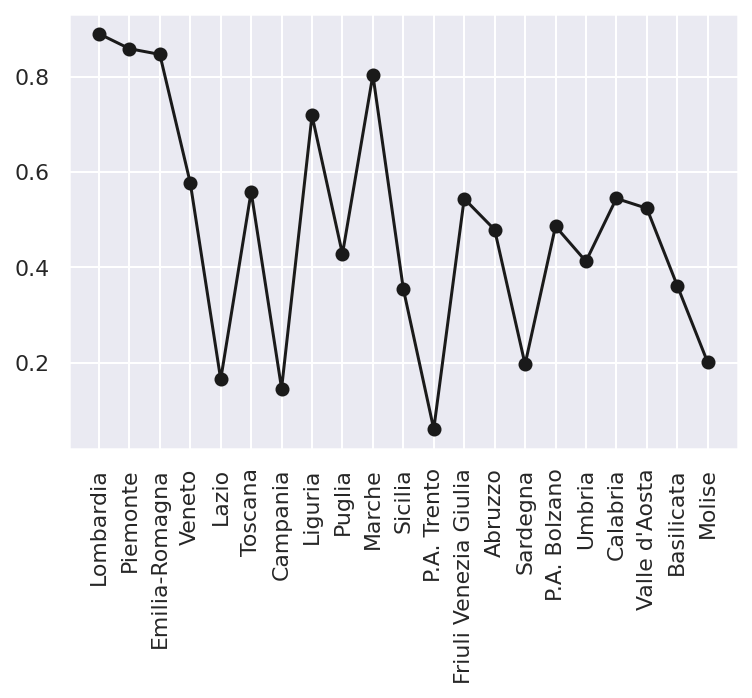

In [15]:
corr_reg=[]
for rr in regg:
    corr_reg.append(regg_1_df[[rr+'C',rr+'D']].corr()[rr+'D'][0])

plot(regg,corr_reg,'ko-')
xticks(rotation=90);

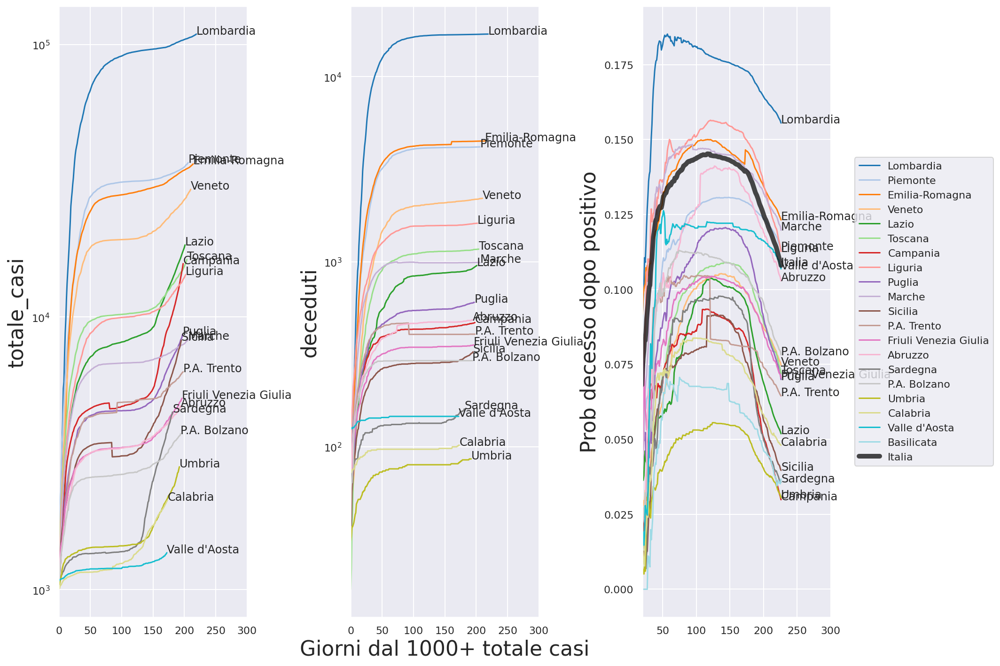

In [16]:
reg100=regioni[regioni.totale_casi>1000]

regg=regioni.sort_values(by=['totale_casi','denominazione_regione'],ascending=False).denominazione_regione.unique()

var='totale_casi'
sns.set_palette("tab20",len(regg))

lag=20
LL=300

figure(figsize=(15,10))
subplot(131)
# for reg in regioni.denominazione_regione.unique():
for rr in regg[:lag]:    
    yy=reg100[reg100['denominazione_regione']==rr][var]
    plot(arange(len(yy)),yy,'-',label=rr)
    if rr not in ('Molise', 'Basilicata'):
        text(arange(len(yy))[-1], array(yy)[-1], rr)

# yy=ita.totale_casi
# plot(yy,label='Italia')
# text(arange(len(yy))[-1], array(yy)[-1], 'Italia')

# legend(loc='center left', bbox_to_anchor=(1.1, 0.5))
yscale('log')
# xlabel('Giorni dal 500+ totale casi',fontsize=22)
ylabel(var,fontsize=22)
xlim([0,LL])

var='deceduti'

subplot(132)
for rr in regg[:lag]:    
    yy=reg100[reg100['denominazione_regione']==rr][var]
    plot(arange(len(yy)),yy,'-',label=rr)
    if rr not in ('Molise', 'Basilicata'):
        text(arange(len(yy))[-1], array(yy)[-1], rr)

# yy=ita.deceduti
# plot(yy,label='Italia')
# text(arange(len(yy))[-1], array(yy)[-1], 'Italia')

# legend(loc='center left', bbox_to_anchor=(1.1, 0.5))
yscale('log')
xlabel('Giorni dal 1000+ totale casi',fontsize=22)
ylabel(var,fontsize=22)
# ylim([])

var='Prob decesso dopo positivo'
# var='Prob decesso dopo ospedalizzato'
# var='Prob intensiva dopo ospedalizzato'
# var='Prob ospedalizzato dopo positivo'
# var='Prob positivo dopo tampone'
# var='Variazione casi'
xlim([0,LL])


subplot(133)
for rr in regg[:lag]:    
    yy=regioni[regioni['denominazione_regione']==rr][var]
    plot(arange(len(yy)),yy,'-',label=rr)
    if rr not in ('Molise', 'Basilicata'):
        text(arange(len(yy))[-1], array(yy)[-1], rr)
yy=(ita.totale_casi/ita.tamponi)
yy=(ita.deceduti/ita.totale_casi)

plot(yy,label='Italia',linewidth=5,color='k',alpha=0.8)
text(arange(len(yy))[-1], array(yy)[-1], 'Italia')
legend(loc='center left', bbox_to_anchor=(1.1, 0.5))
# yscale('log')
# xlabel('Giorni dal 500+ totale casi',fontsize=22)
ylabel(var,fontsize=22)
xlim([20,LL])
# gca().set_ylim(bottom=0, top=0.08)
tight_layout()

/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:726: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/usr/local/lib/python3.6/dist-packages/pandas/core/algorithms.py:1972: RuntimeWarning: invalid value encountered in subtract
  out_arr[res_indexer] = arr[res_indexer] - arr[lag_indexer]
/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:726: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/usr/local/lib/python3.6/dist-packages/pandas/core/algorithms.py:1972: RuntimeWarning: invalid value encountered in subtract
  out_arr[res_indexer] = arr[res_indexer] - arr[lag_indexer]
/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:726: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/usr/local/lib/python3.6/dist-packages/pandas/core/algorithms.py:1972: RuntimeWarning: invalid value encountered in subtr

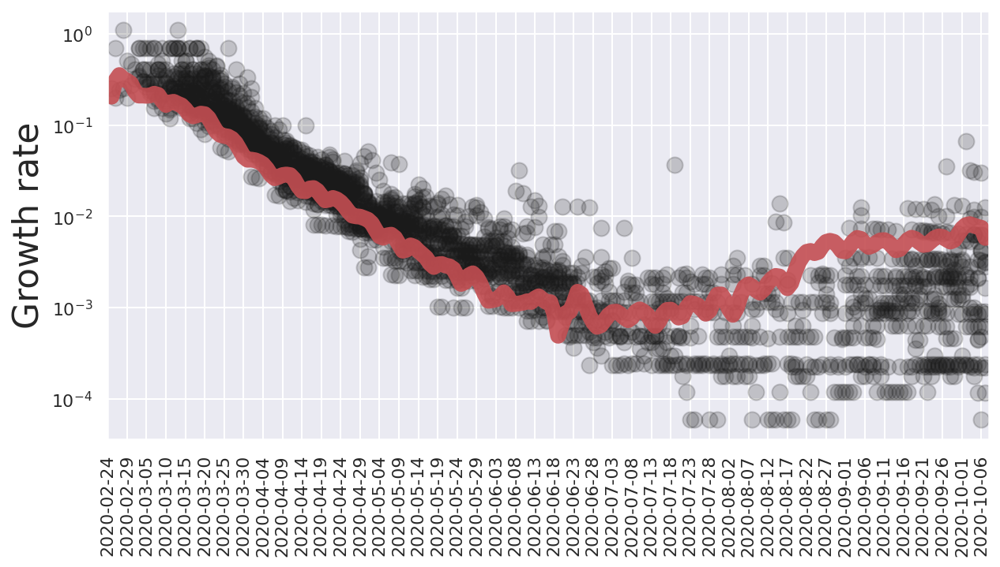

In [17]:
var='deceduti'
r0='Lombardia'

tau=1

figure(figsize=(10,5))

# fig.set_facecolor('w')

i=1
for rr in regg[:20]:    
    yy0=(regioni[regioni['denominazione_regione']==rr][var]).rolling(7,
        win_type='gaussian',
        min_periods=1,
        center=True).mean(std=1).round()
#     yy=yy0.diff()/yy0.shift(periods=1)
    yy=log(yy0).diff()
    plot(arange(len(yy)),yy,'ko',label=rr,alpha=0.2,markersize=10)

yyy0=(ita['totale_casi']).rolling(7,
        win_type='gaussian',
        min_periods=1,
        center=True).mean(std=1).round()
# yyy=yyy0.diff()/yyy0.shift(periods=1)
yyy=log(yyy0).diff()
plot(yyy,'r-',linewidth=10,markersize=10,alpha=0.9)
# text(arange(len(yyy))[-10], array(yyy)[-10], 'Italy',fontsize=20)
# legend(loc='center left', bbox_to_anchor=(1.1, 0.5))
# yscale('log')
# xlabel('Giorni dal 500+ totale casi',fontsize=22)
ylabel('Growth rate',fontsize=22)
yscale('log')
# legend()
# gca().set_ylim(bottom=1)
xlim([0,len(yyy)]);
# ylim([0,100])
skip=5
gca().set_xticks(range(len(yy))[::skip]);
gca().set_xticklabels(date[::skip]);
xticks(rotation=90);

(0.0, 250.0)

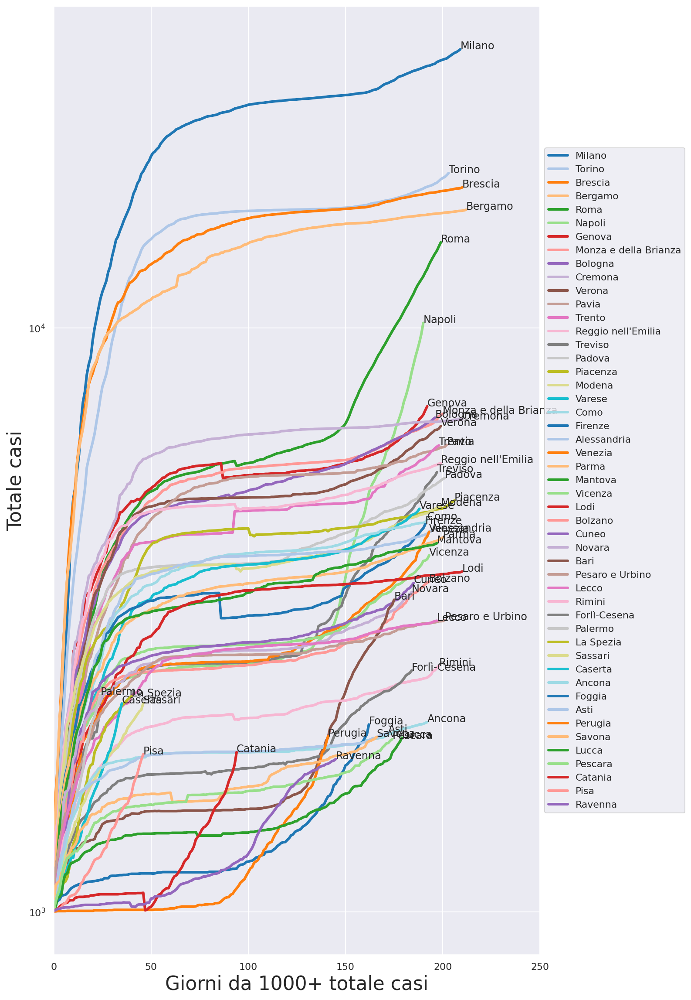

In [18]:
pro100=province[province.totale_casi>1000]

prov=province.sort_values(by=['totale_casi','denominazione_provincia'],ascending=False).denominazione_provincia.unique()

var='totale_casi'
sns.set_palette("tab20",50)

figure(figsize=(10,20))
# for reg in regioni.denominazione_regione.unique():
for rr in prov[:50]:
    if rr!='In fase di definizione/aggiornamento':
        yy=pro100[pro100['denominazione_provincia']==rr][var]
        plot(arange(len(yy)),yy,'-',label=rr,linewidth=3)
        text(arange(len(yy))[-1], array(yy)[-1], rr)

legend(loc='center left', bbox_to_anchor=(1, 0.5))
yscale('log')
xlabel('Giorni da 1000+ totale casi',fontsize=22)
ylabel('Totale casi',fontsize=22)
# ylim([500,100000])
xlim([0,250])

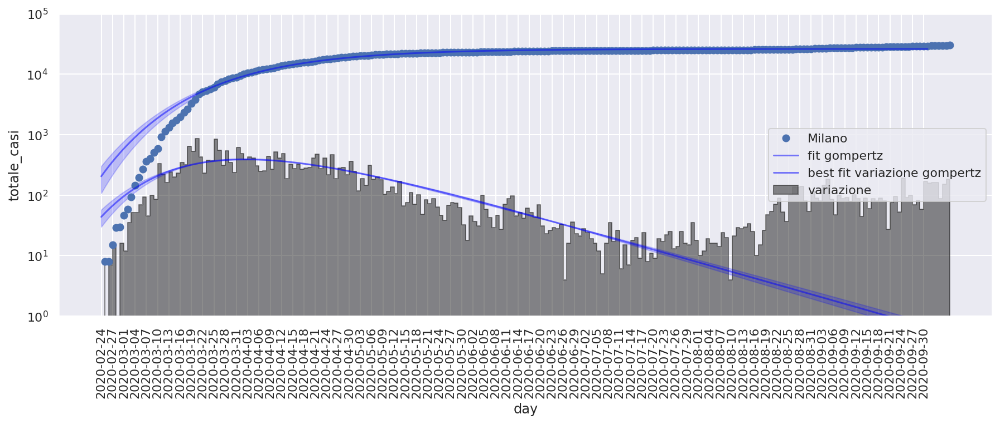

[[Model]]
    Model(step, form='logistic')
[[Fit Statistics]]
    # fitting method   = leastsq
    # function evals   = 42
    # data points      = 227
    # variables        = 3
    chi-square         = 4.7096e+08
    reduced chi-square = 2102496.83
    Akaike info crit   = 3307.79041
    Bayesian info crit = 3318.06526
[[Variables]]
    amplitude:  25687.5239 +/- 133.385084 (0.52%) (init = 30030)
    center:     48.7196185 +/- 0.60875922 (1.25%) (init = 113)
    sigma:      16.0849694 +/- 0.54313340 (3.38%) (init = 32.28571)
[[Correlations]] (unreported correlations are < 0.100)
    C(amplitude, center) =  0.406
    C(amplitude, sigma)  =  0.375
    C(center, sigma)     =  0.136 [[Model]]
    Model(gompertz_model)
[[Fit Statistics]]
    # fitting method   = leastsq
    # function evals   = 42
    # data points      = 227
    # variables        = 3
    chi-square         = 3.0086e+08
    reduced chi-square = 1343145.47
    Akaike info crit   = 3206.06913
    Bayesian info crit = 3216.

In [19]:
drange=pd.date_range(start="2020-02-24",end="2020-10-01")
drange=array(drange.format(formatter=lambda x: x.strftime('%Y-%m-%d')))
LL=len(drange)


reg='Milano'
yy='totale_casi'

data=province[province['denominazione_provincia']==reg][yy]
xx=arange(len(data))

model1 = StepModel(form='logistic')
params1 = model1.guess(data, x=xx)

model2 = Model(gompertz_model)
params2 = model2.make_params(a=1, b=1, c=10000)

result1 = model1.fit(data, params1, x=xx)
result2 = model2.fit(data, params2, x=xx)


figure(figsize=(15,5))

# subplot(121)
plot(xx,data,'bo',label=reg)

# result.plot_fit()
# regioni[regioni['denominazione_regione']==reg][yy].diff().plot(style='.-',markersize=10)
xp=arange(LL)

dely1 = result1.eval_uncertainty(x=xp,sigma=2)
dely2 = result2.eval_uncertainty(x=xp,sigma=2)


# fill_between(xp, (result1.eval(x=xp)-dely1), (result1.eval(x=xp)+dely1), color="red",alpha=0.2)
fill_between(xp, (result2.eval(x=xp)-dely2), (result2.eval(x=xp)+dely2), color="blue",alpha=0.2)

# plot((result1.eval(x=xp)),label='fit logistics',color='red',alpha=0.5)
plot((result2.eval(x=xp)),label='fit gompertz' ,color='blue',alpha=0.5)

gca().set_xticks(xp[::3]);
# gca().set_xticklabels(province[province['denominazione_provincia']==reg].data[province[province['denominazione_provincia']==reg].index]);
gca().set_xticklabels(drange[::3]);
# # gca().get_yaxis().set_major_formatter(matplotlib.ticker.ScalarFormatter())
xticks(rotation=90);
# xlabel('day')
ylabel(yy)


legend()

# subplot(122)
fill_between(xx,data.diff(),label='variazione',alpha=0.5,step="pre",color='k')
# plot(diff(result1.eval(x=xp)),label='best fit variazione logistic',color='red',alpha=0.5)
plot(diff(result2.eval(x=xp)),label='best fit variazione gompertz',color='blue',alpha=0.5)

# fill_between(xp[:-1], diff(result1.eval(x=xp)-dely1), diff(result1.eval(x=xp)+dely1), color="red",alpha=0.2)
fill_between(xp[:-1], diff(result2.eval(x=xp)-dely2), diff(result2.eval(x=xp)+dely2), color="blue",alpha=0.2)


# yscale('log')

skip=3
gca().set_xticks(xp[::skip]);
# gca().set_xticklabels(data.data[data.index]);
gca().set_xticklabels(drange[::skip]);
# # gca().get_yaxis().set_major_formatter(matplotlib.ticker.ScalarFormatter())
xticks(rotation=90);
xlabel('day')
ylabel(yy)
ylim([0,200])
yscale('log')
gca().set_ylim(bottom=1,top=100000)


legend()
show()
print(result1.fit_report(),result2.fit_report())


# Reproduction numbers

In [20]:
def get_posteriors(sr, window=7, min_periods=1):
    # We create an array for every possible value of Rt
    R_T_MAX = 12
    r_t_range = np.linspace(0, R_T_MAX, R_T_MAX*100+1)
    GAMMA=1/7
    lam = sr[:-1].values * np.exp(GAMMA * (r_t_range[:, None] - 1))

    # Note: if you want to have a Uniform prior you can use the following line instead.
    # I chose the gamma distribution because of our prior knowledge of the likely value
    # of R_t.
    
    prior0 = np.full(len(r_t_range), np.log(1/len(r_t_range)))
#     prior0 = np.log(sps.gamma(a=3).pdf(r_t_range) + 1e-14)

    likelihoods = pd.DataFrame(
        # Short-hand way of concatenating the prior and likelihoods
        data = np.c_[prior0, sps.poisson.logpmf(sr[1:].values, lam)],
        index = r_t_range,
        columns = sr.index)

    # Perform a rolling sum of log likelihoods. This is the equivalent
    # of multiplying the original distributions. Exponentiate to move
    # out of log.
    posteriors = likelihoods.rolling(window,
                                     axis=1,
                                     min_periods=min_periods).sum()
    posteriors = np.exp(posteriors)

    # Normalize to 1.0
    posteriors = posteriors.div(posteriors.sum(axis=0), axis=1)
    
    return posteriors


# def highest_density_interval(pmf, p=.95):
    
#     # If we pass a DataFrame, just call this recursively on the columns
#     if(isinstance(pmf, pd.DataFrame)):
#         return pd.DataFrame([highest_density_interval(pmf[col]) for col in pmf],
#                             index=pmf.columns)
    
#     cumsum = np.cumsum(pmf.values)
#     best = None
#     for i, value in enumerate(cumsum):
#         for j, high_value in enumerate(cumsum[i+1:]):
#             if (high_value-value > p) and (not best or j<best[1]-best[0]):
#                 best = (i, i+j+1)
#                 break
            
#     low = pmf.index[best[0]]
#     high = pmf.index[best[1]]
#     return pd.Series([low, high], index=['Low', 'High'])

def highest_density_interval(pmf, p=.95):
    low = [pmf[col].index[(pmf[col].cumsum()>1-p)][0] for col in pmf.columns]
    high = [pmf[col].index[(pmf[col].cumsum()>p)][0] for col in pmf.columns]
    return pd.Series([low, high], index=['Low', 'High'])

    
    

# Reproduction Provincie

/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:726: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:726: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/usr/local/lib/python3.6/dist-packages/pandas/core/algorithms.py:1972: RuntimeWarning: invalid value encountered in subtract
  out_arr[res_indexer] = arr[res_indexer] - arr[lag_indexer]
/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:726: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/usr/local/lib/python3.6/dist-packages/pandas/core/algorithms.py:1972: RuntimeWarning: invalid value encountered in subtract
  out_arr[res_indexer] = arr[res_indexer] - arr[lag_indexer]
/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:726: RuntimeWarning: divide by zero encountered in log
  res

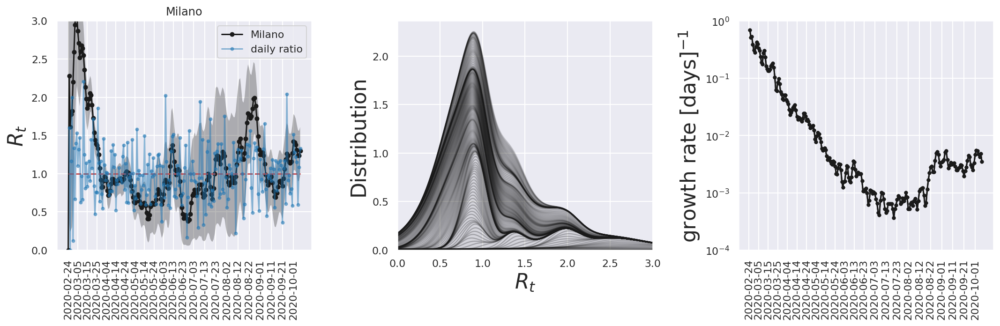

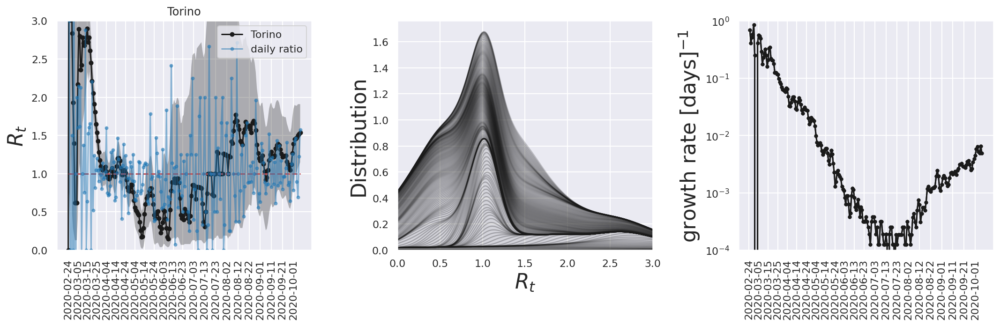

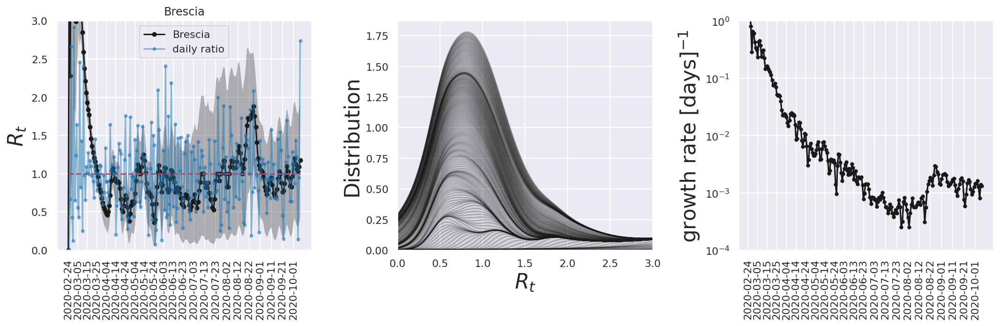

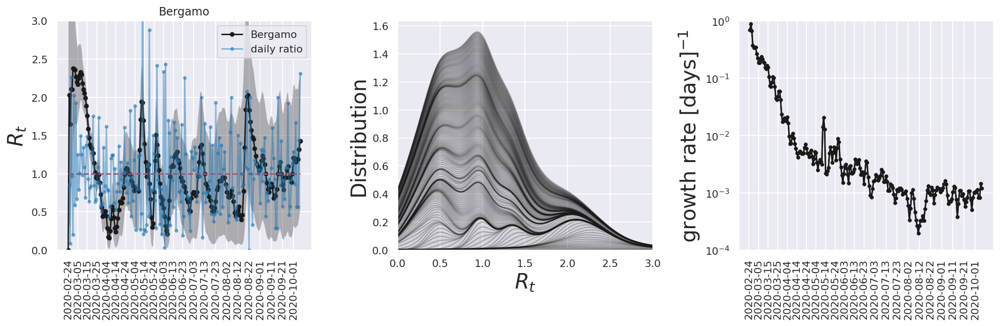

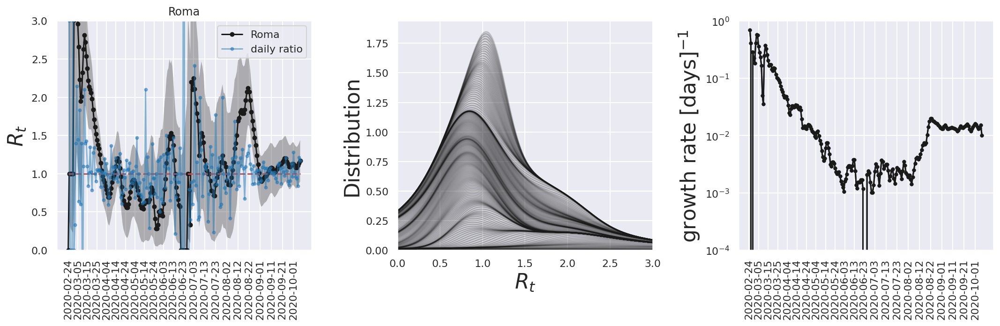

...

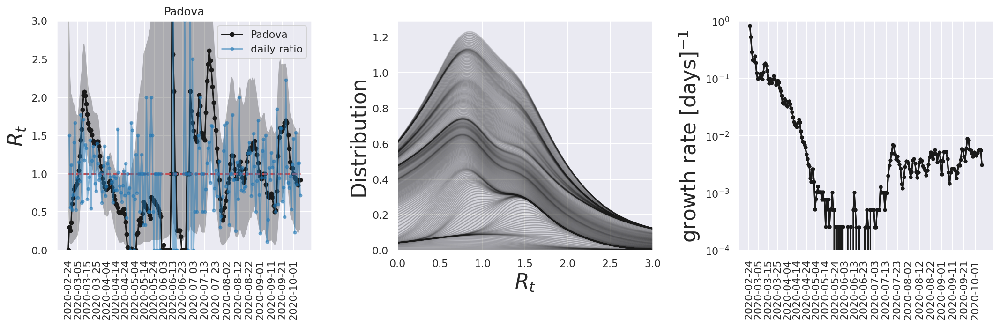

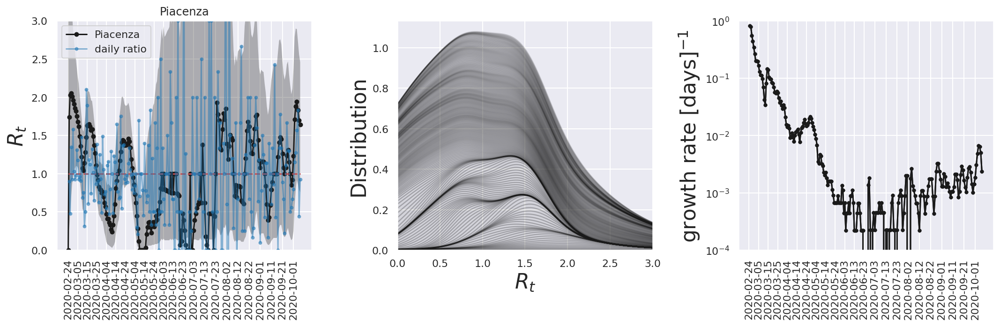

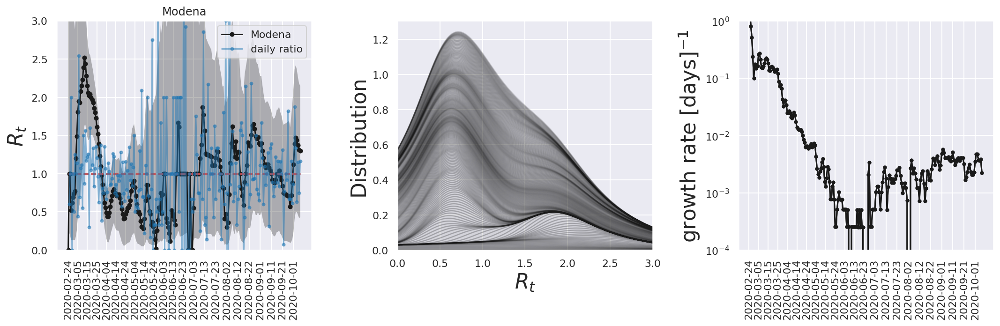

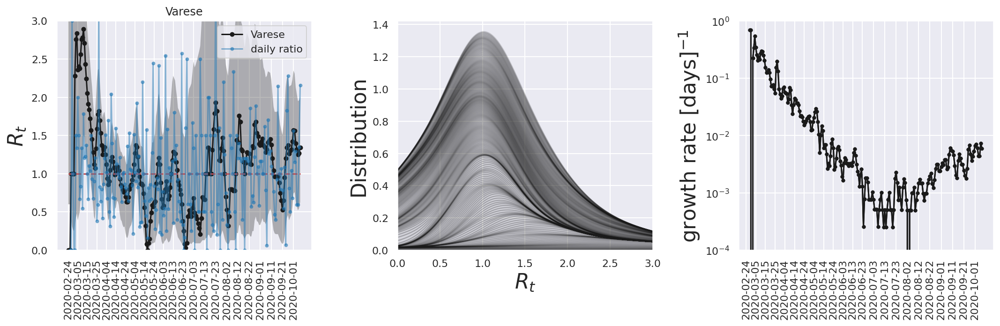

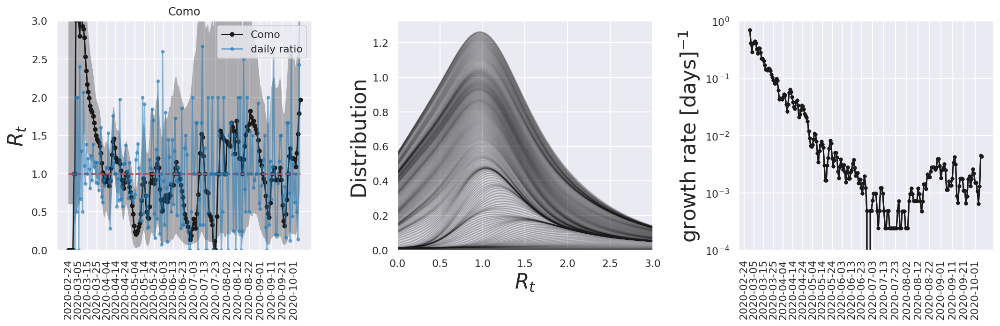

In [21]:
regg='Lazio'
prov_reg=province[province.denominazione_regione==regg]

prov=province.sort_values(by=['totale_casi','denominazione_provincia'],ascending=False).denominazione_provincia.unique()
# prov=prov_reg.sort_values(by=['totale_casi','denominazione_provincia'],ascending=False).denominazione_provincia.unique()


i=1

lag=20
skip=10

for reg in prov[:lag]:
    if reg!='In fase di definizione/aggiornamento':
        yy=province[province['denominazione_provincia']==reg]['totale_casi']
    k=yy.diff().rolling(7,
        win_type='gaussian',
        min_periods=1,
        center=True).mean(std=2).round()
    
    posteriors = get_posteriors(k, window=10)

    hdi = highest_density_interval(posteriors, p=0.95)

    most_likely = posteriors.idxmax()
    
    figure(figsize=(15,5))
    subplot(131)
    most_likely.plot(marker='o',
                    label=reg,
                    c='k',
                    markersize=4)
    plot(most_likely.index,ones_like(k),'r--')
    fill_between(most_likely.index,
                 hdi['Low'],
                 hdi['High'],
                 color='k',
                 alpha=.3,
                 lw=0)   
    
    (yy.diff()/yy.diff().shift(periods=1).rolling(7,
    win_type='gaussian',
    min_periods=1,
    center=True).mean(std=3).round()).plot(style='.-',alpha=0.5,label='daily ratio')
    
    legend()
    title(reg)
    ylim([0,3])
    gca().set_xticks(most_likely.index[::skip]);
    # gca().set_xticklabels(data.data[data.index]);
    gca().set_xticklabels(date[::skip]);
    xticks(rotation=90);
    ylabel('$R_t$',fontsize=22)
    
    subplot(132)
    
    posteriors.plot.area(color='k',legend='',xlim=[0,4],alpha=0.1,ax=plt.gca())
    xlabel('$R_t$',fontsize=22)
    ylabel('Distribution',fontsize=22)
    xlim([0,3])
    
    
    subplot(133)
#     yyy=(yy.diff()/yy.shift(periods=1).rolling(14,
#         win_type='gaussian',
#         min_periods=1,
#         center=True).mean(std=2).round())
    yyy=(log(yy.rolling(3,
        win_type='gaussian',
        min_periods=1,
        center=True).mean(std=1).round()).diff())
    (yyy).plot(style='k.-',ax=plt.gca())

    (yyy).plot(style='k.-',ax=plt.gca())
#     plot(yy.index,ita.totale_casi.diff()/ita.totale_casi.diff().shift(periods=1),'k-')
    gca().set_xticks(yy.index[::skip]);
    # gca().set_xticklabels(data.data[data.index]);
    gca().set_xticklabels(date[::skip]);
    xticks(rotation=90);
    ylabel('growth rate [days]$^{-1}$',fontsize=22)
    gca().set_ylim(bottom=0.0001,top=1)
    yscale('log')
    tight_layout()

# Reproduction Regioni

/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:726: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:726: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/usr/local/lib/python3.6/dist-packages/pandas/core/algorithms.py:1972: RuntimeWarning: invalid value encountered in subtract
  out_arr[res_indexer] = arr[res_indexer] - arr[lag_indexer]
/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:726: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/usr/local/lib/python3.6/dist-packages/pandas/core/algorithms.py:1972: RuntimeWarning: invalid value encountered in subtract
  out_arr[res_indexer] = arr[res_indexer] - arr[lag_indexer]
/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:726: RuntimeWarning: divide by zero encountered in log
  res

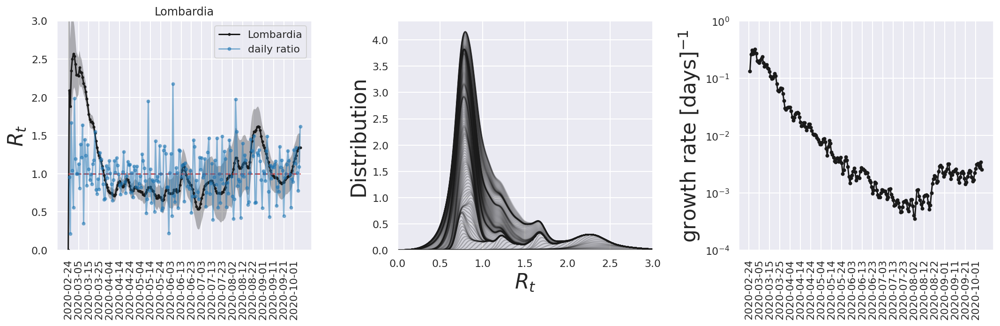

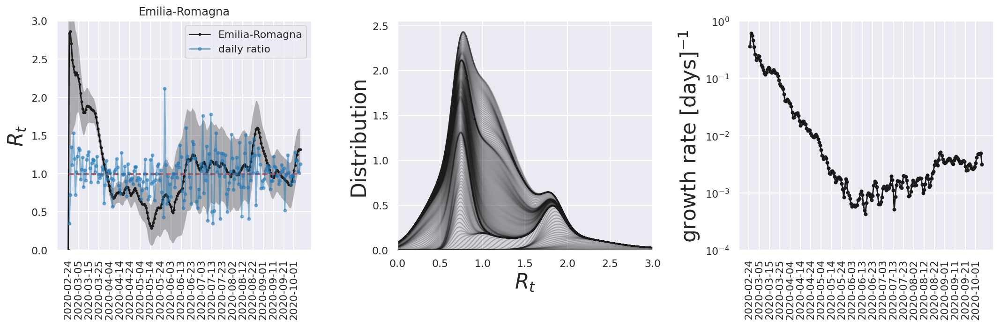

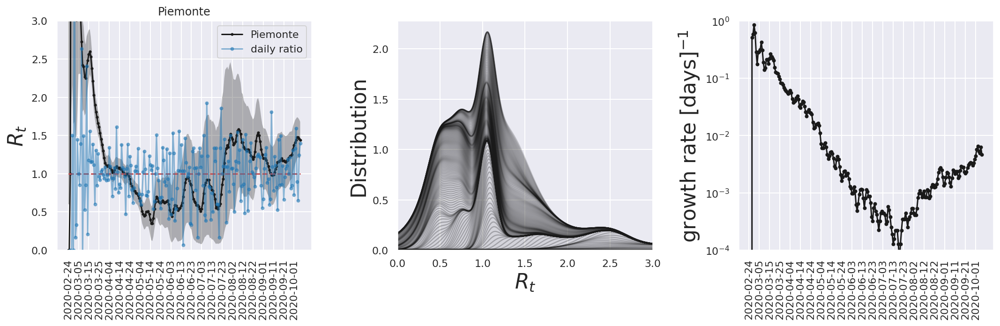

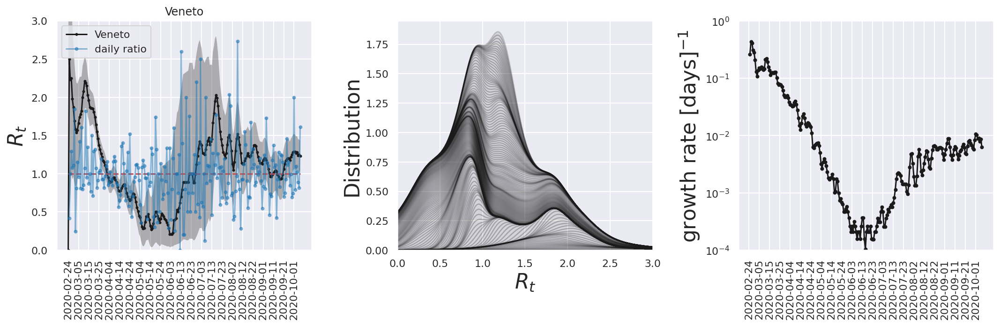

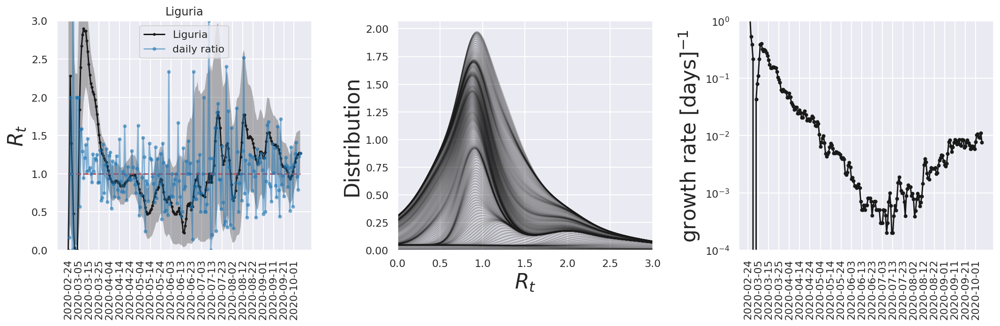

...

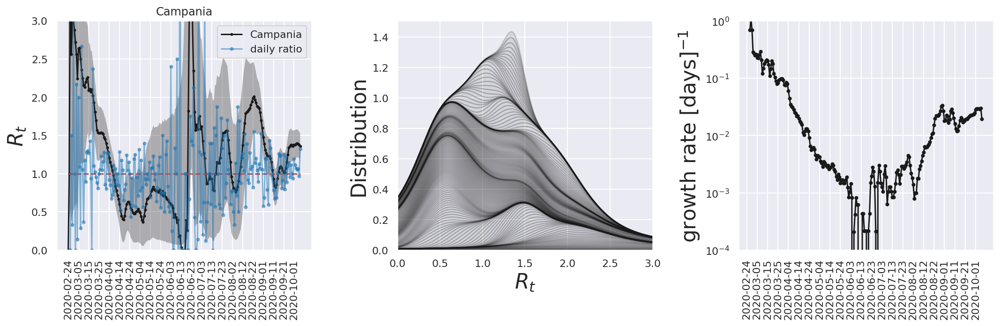

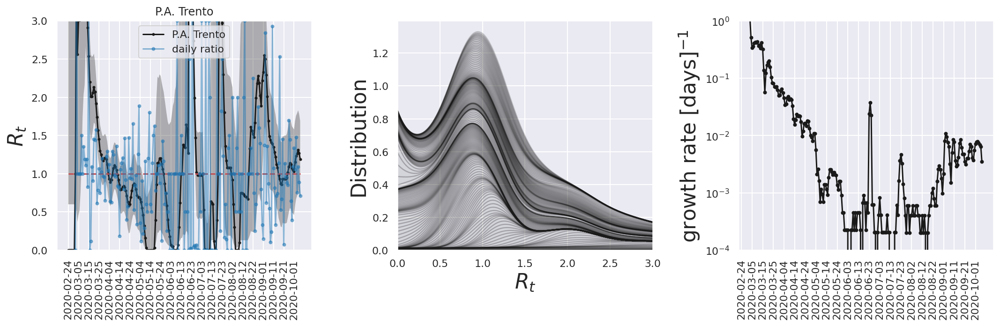

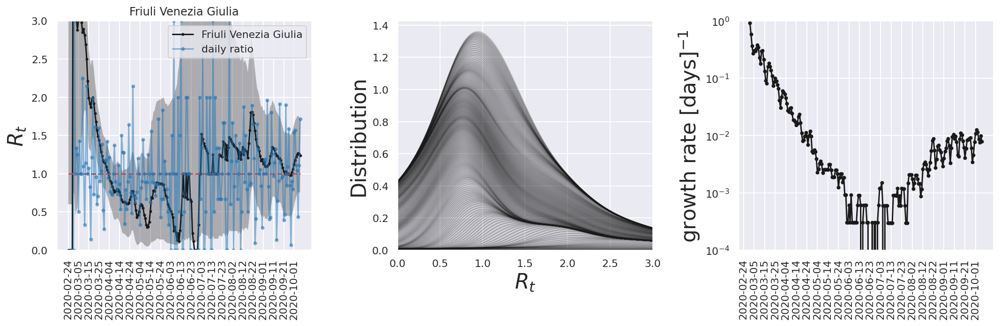

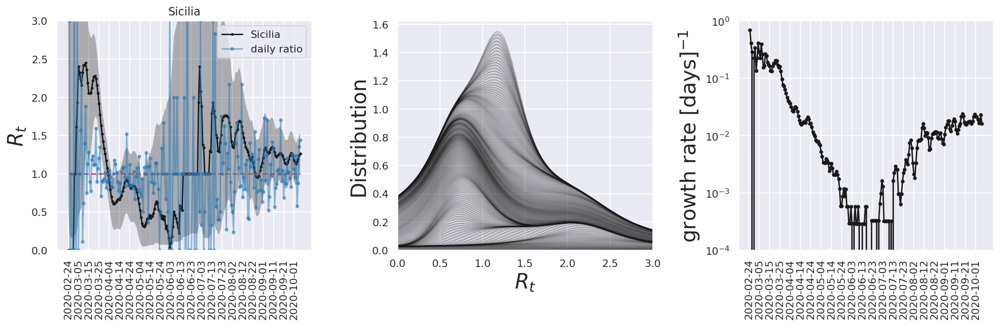

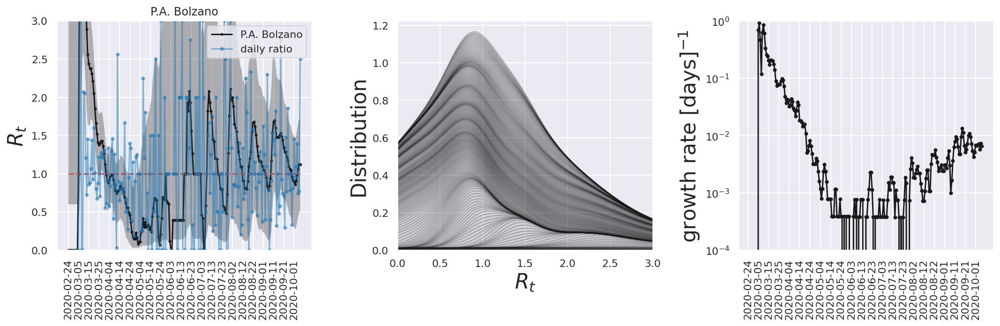

In [22]:
reglist=regioni.sort_values(by=['deceduti','denominazione_regione'],ascending=False).denominazione_regione.unique()
i=1

lag=15
skip=10

for reg in reglist[:lag]:
    yy=regioni[regioni['denominazione_regione']==reg]['totale_casi']
    k=yy.diff().rolling(7,
        win_type='gaussian',
        min_periods=1,
        center=True).mean(std=2).round()
    
    posteriors = get_posteriors(k, window=14)

    hdi = highest_density_interval(posteriors, p=0.95)

    most_likely = posteriors.idxmax()
    
    figure(figsize=(15,5))
    subplot(131)
    most_likely.plot(marker='.',
                    label=reg,
                    c='k',
                    markersize=4)
    plot(most_likely.index,ones_like(k),'r--')
    fill_between(most_likely.index,
                 hdi['Low'],
                 hdi['High'],
                 color='k',
                 alpha=.3,
                 lw=0)   
    
    (yy.diff()/yy.diff().shift(periods=1).rolling(7,
    win_type='gaussian',
    min_periods=1,
    center=True).mean(std=3).round()).plot(style='.-',alpha=0.5,label='daily ratio')
    
    legend()
    title(reg)
    ylim([0,3])
    gca().set_xticks(most_likely.index[::skip]);
    # gca().set_xticklabels(data.data[data.index]);
    gca().set_xticklabels(date[::skip]);
    xticks(rotation=90);
    ylabel('$R_t$',fontsize=22)
    
    subplot(132)
    
    
    posteriors.plot.area(color='k',legend='',xlim=[0,4],alpha=0.1,ax=plt.gca())
    xlabel('$R_t$',fontsize=22)
    ylabel('Distribution',fontsize=22)
    xlim([0,3])
    
    
    subplot(133)
#     yyy=(yy.diff()/yy.shift(periods=1).rolling(7,
#         win_type='gaussian',
#         min_periods=1,
#         center=True).mean(std=1).round())
    yyy=(log(yy.rolling(3,
        win_type='gaussian',
        min_periods=1,
        center=True).mean(std=1).round()).diff())
    (yyy).plot(style='k.-',ax=plt.gca())

#     plot(yy.index,ita.totale_casi.diff()/ita.totale_casi.diff().shift(periods=1),'k-')
    gca().set_xticks(yy.index[::skip]);
    # gca().set_xticklabels(data.data[data.index]);
    gca().set_xticklabels(date[::skip]);
    xticks(rotation=90);
    ylabel('growth rate [days]$^{-1}$',fontsize=22)
    gca().set_ylim(bottom=0.0001,top=1)
    yscale('log')
    tight_layout()

# World

---


In [23]:
CONFIRMED='https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_confirmed_global.csv'
DEATH='https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_deaths_global.csv'

world0_c=pd.read_csv(CONFIRMED)
world0_d=pd.read_csv(DEATH)

In [24]:
date_cols = world0_c.filter(regex=('^\d+/\d+/\d+$')).columns.array
world0_c = pd.melt(world0_c, id_vars=['Province/State', 'Country/Region'], value_vars=date_cols, var_name='Date', value_name='Confirmed')
world0_c.Date = pd.to_datetime(world0_c.Date, format='%m/%d/%y')
world_c=world0_c.groupby(['Country/Region','Date']).agg({'Confirmed': 'sum'})
world_c.columns=['Confirmed']
world_c=world_c.reset_index()

# date_cols = world0_d.filter(regex=('^\d+/\d+/\d+$')).columns.array
world0_d = pd.melt(world0_d, id_vars=['Province/State', 'Country/Region'], value_vars=date_cols, var_name='Date', value_name='Deaths')
world0_d.Date = pd.to_datetime(world0_d.Date, format='%m/%d/%y')
world_d=world0_d.groupby(['Country/Region','Date']).agg({'Deaths': 'sum'})
world_d.columns=['Deaths']
world_d=world_d.reset_index()


world=world_c
world['Deaths']=world_d.Deaths
world['Estimated Fatality']=100*world.Deaths/world.Confirmed
world['Date'] = pd.to_datetime(world.Date, format='%m/%d/%y')

datew=world.Date.values.astype('datetime64[D]')

In [25]:
world_tot=world.groupby(['Date']).agg({'Confirmed': 'sum','Deaths': 'sum','Estimated Fatality': 'std'})
world_tot.columns=['Confirmed','Deaths','Estimated Fatality']
world_tot=world_tot.reset_index()
world_tot['Estimated Fatality mean']=100*world_tot.Deaths/world_tot.Confirmed

world_tot.rename(columns={"Estimated Fatality": "Estimated Fatality std"})

,Date,Confirmed,Deaths,Estimated Fatality std,Estimated Fatality mean
0,2020-01-22,555,17,$1.266,$3.063
1,2020-01-23,654,18,$0.990,$2.752
2,2020-01-24,941,26,$0.942,$2.763
3,2020-01-25,1434,42,$0.901,$2.929
4,2020-01-26,2118,56,$0.749,$2.644
...,...,...,...,...,...
254,2020-10-02,34582698,1027827,$3.128,$2.972
255,2020-10-03,34902647,1033177,$3.121,$2.960
256,2020-10-04,35150468,1036941,$3.118,$2.950
257,2020-10-05,35475879,1043945,$3.114,$2.943


(0.0, 300.0)

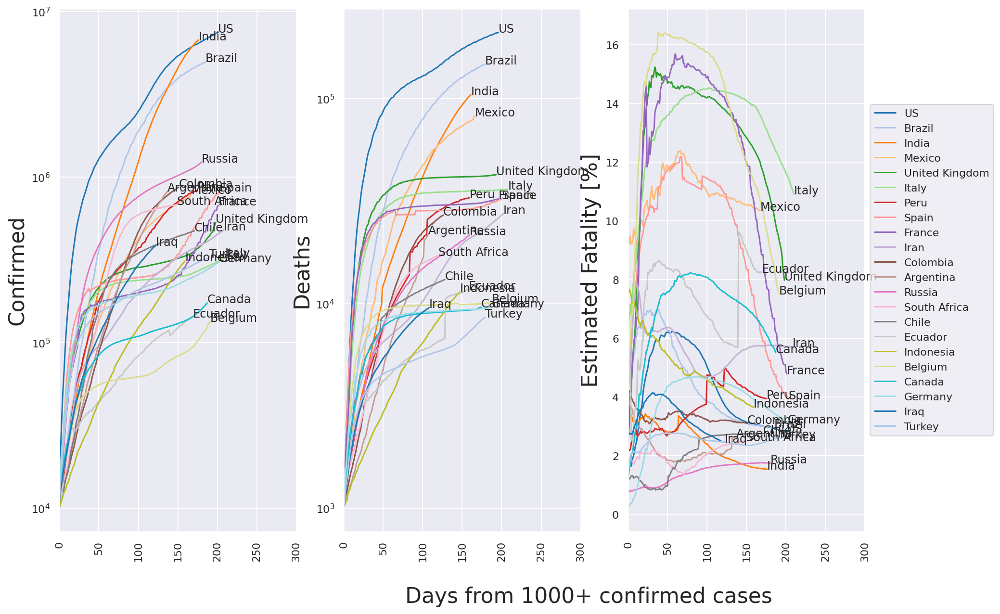

In [26]:
SEL=array(['Italy',
           'US',
          'Germany',
          'France',
          'Spain',
          'United Kingdom',
          'Ireland',
          'Switzerland',
          'Sweden',
          'Greece',
          'Denmark',
          'Netherlands',
          'Norway',
          'Portugal',
          'Israel','Japan','China','Singapore','Argentina','Brazil','India'])

countries=world.sort_values(by=['Deaths','Country/Region'],ascending=False)['Country/Region'].unique()

LL=300
lag=22
sns.set_palette("tab20",lag)

sel='Netherlands'

w100=world[world.Confirmed>10000]

var='Confirmed'
# var='deaths_after_positive'

figure(figsize=(15,10))
subplot(131)
for ss in countries[:lag]:
#     if ss==sel:
#         yy=w100[w100['Country/Region']==ss][var]
#         plot(arange(len(yy)),yy,'r-',label=ss)
#     else:
    yy=w100[w100['Country/Region']==ss][var]
    plot(arange(len(yy)),yy,'-',label=ss,alpha=1)
    if ss!='China':
        text(arange(len(yy))[-1], array(yy)[-1], ss)
    else:
        text(arange(len(yy))[50], array(yy)[-1], ss)

# legend(loc='center left', bbox_to_anchor=(1.05, -0.7))
xticks(rotation=90);
yscale('log')
ylabel(var,fontsize=22)
# xlabel('Days from 1000+ confirmed cases',fontsize=22)
xlim([0,LL])

var='Deaths'
# var='deaths_after_positive'


w100=world[world.Deaths>1000]

subplot(132)

for ss in countries[:lag]:
#     if ss==sel:
#         yy=w100[w100['Country/Region']==ss][var]
#         plot(arange(len(yy)),yy,'r-',label=ss)
#     else:
    yy=w100[w100['Country/Region']==ss][var]
    plot(arange(len(yy)),yy,'-',label=ss,alpha=1)
    if ss!='China':
        text(arange(len(yy))[-1], array(yy)[-1], ss)
    else:
        text(arange(len(yy))[50], array(yy)[-1], ss)
# legend(loc='center left', bbox_to_anchor=(1, 0.5))
xticks(rotation=90);
yscale('log')
ylabel(var,fontsize=22)
# xlabel('Days from 1000+ confirmed cases',fontsize=22)
xlim([0,LL])


var='Estimated Fatality'

w100=world[world.Confirmed>10000]
subplot(133)

for ss in countries[:lag]:
#     if ss==sel:
#         yy=w100[w100['Country/Region']==ss][var]
#         plot(arange(len(yy)),yy,'r-',label=ss)
#     else:
    yy=w100[w100['Country/Region']==ss][var]
    plot(arange(len(yy)),yy,'-',label=ss,alpha=1)
    if ss!='China':
        text(arange(len(yy))[-1], array(yy)[-1], ss)
    else:
        text(arange(len(yy))[50], array(yy)[-1], ss)

legend(loc='center left', bbox_to_anchor=(1, 0.5))
xticks(rotation=90);
# yscale('log')
ylabel(var+' [%]',fontsize=22)
text(-50, -3, 'Days from 1000+ confirmed cases', ha='center',fontsize=22)
xlim([0,LL])

#tight_layout()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:24: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


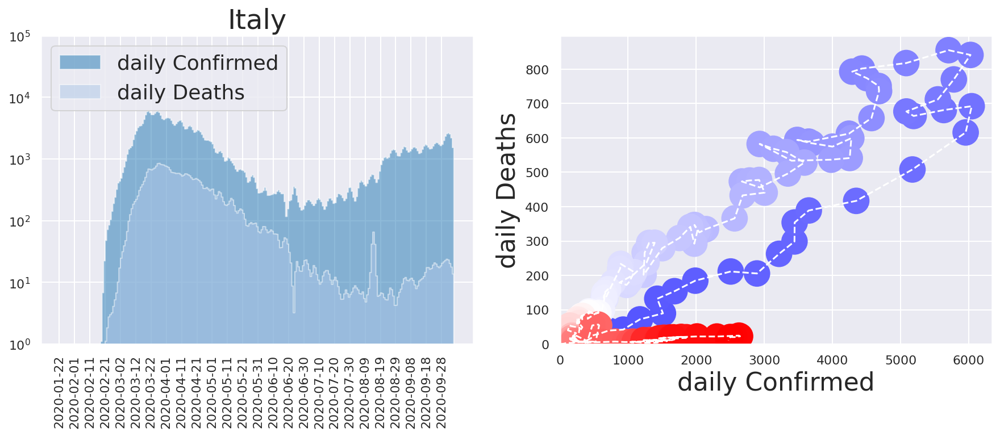

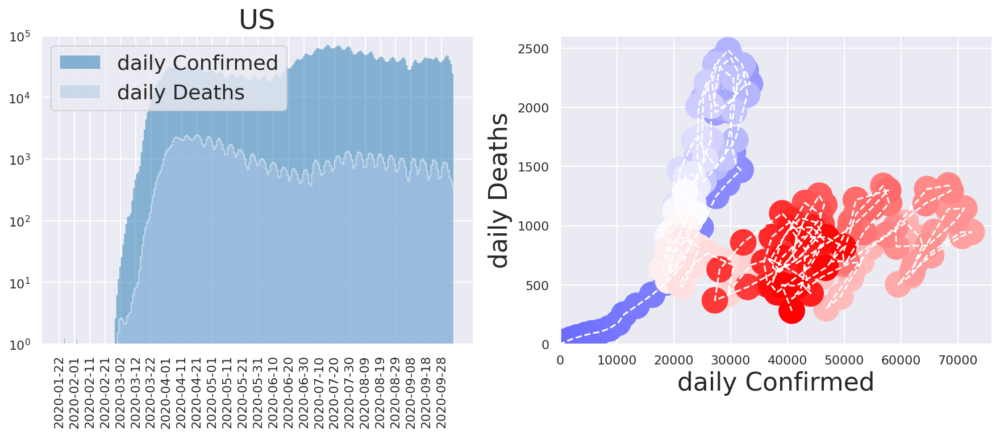

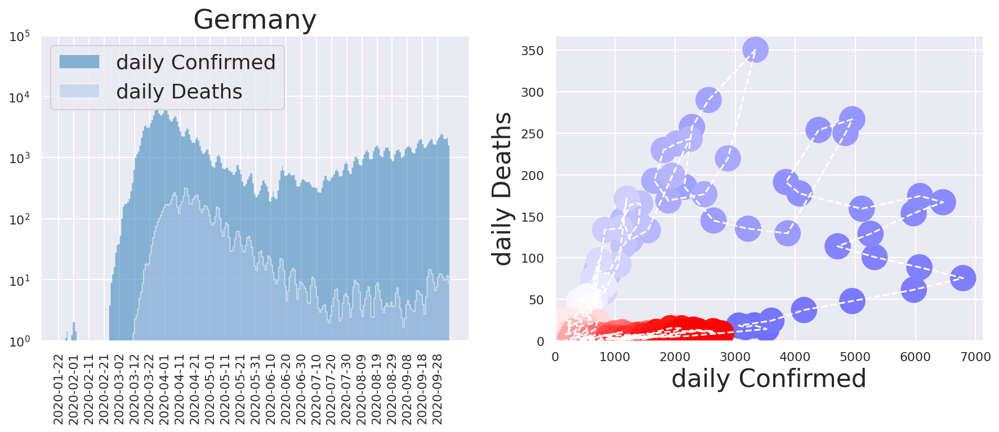

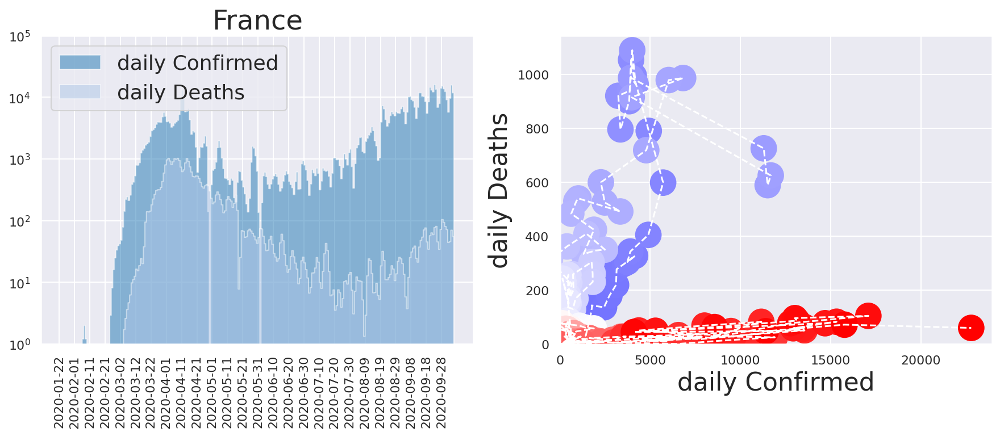

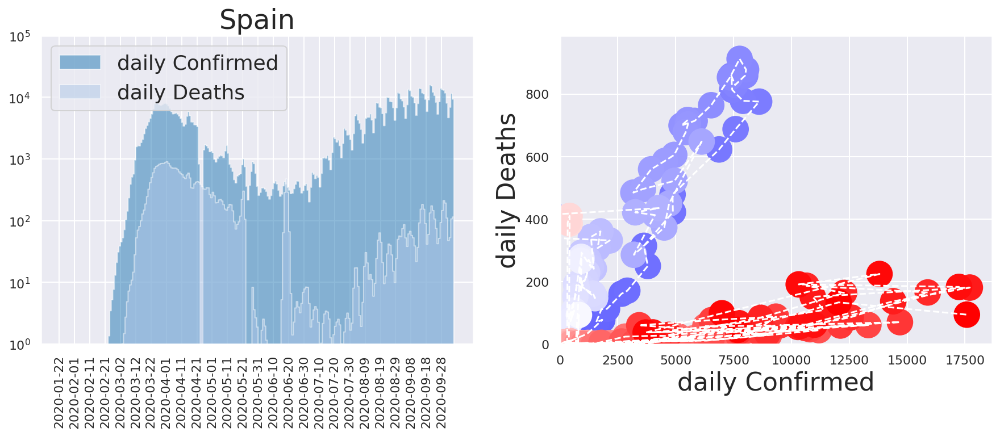

...

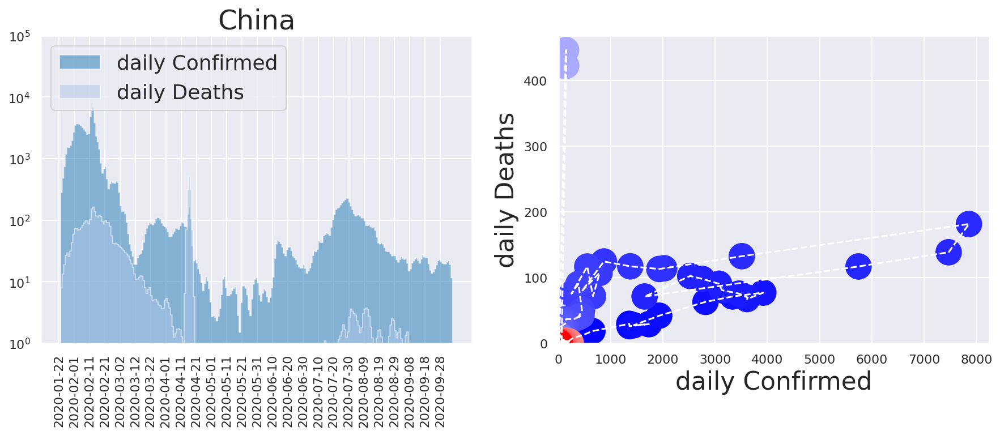

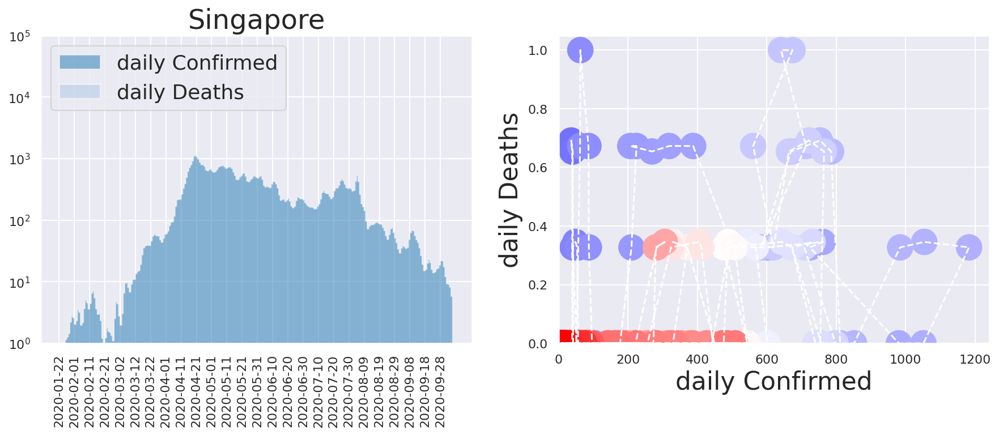

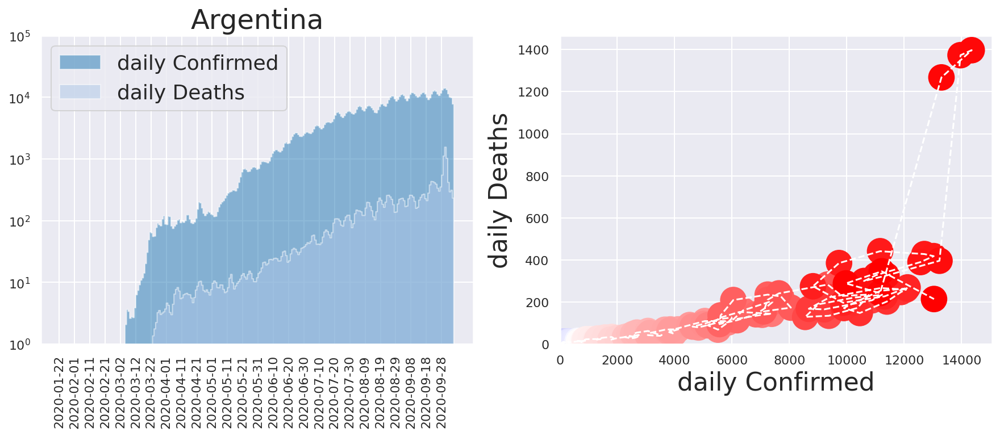

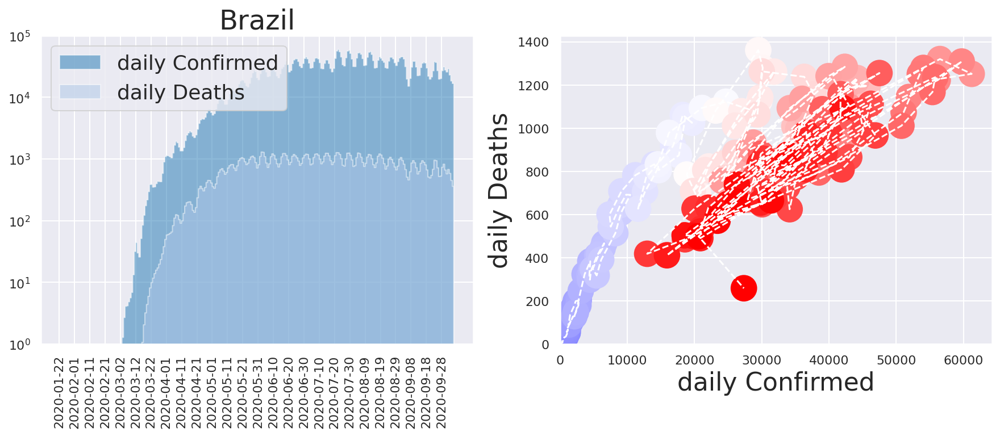

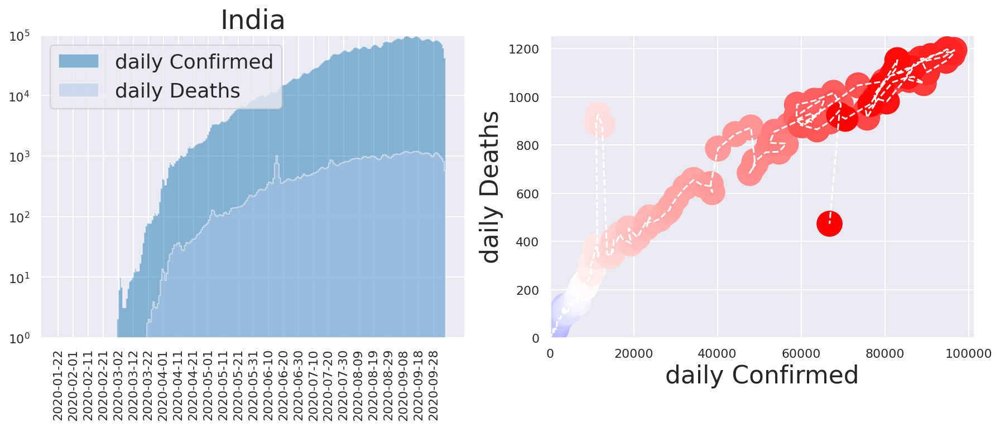

In [27]:
ss='Italy'
skip=10

SEL=array(['Italy',
           'US',
          'Germany',
          'France',
          'Spain',
          'United Kingdom',
          'Ireland',
          'Switzerland',
          'Sweden',
          'Greece',
          'Denmark',
          'Netherlands',
          'Norway',
          'Portugal',
          'Israel','Japan','China','Singapore','Argentina','Brazil','India'])
countries=world.sort_values(by=[var,'Country/Region'],ascending=True)['Country/Region'].unique()


for ss in SEL:
# for ss in countries[:20]:
    figure(figsize=(15,5))

    subplot(121)
    yy=world[world['Country/Region']==ss]
    # plot(yy.Date,yy.Confirmed,label='Confirmed',linewidth=3)
    fill_between(yy.Date,yy.Confirmed.rolling(7,
        win_type='gaussian',
        min_periods=1,
        center=True).mean(std=1).diff(),alpha=0.5,step="pre",label='daily Confirmed')

    # plot(yy.Date,yy.Deaths,label='Deaths',linewidth=3)
    fill_between(yy.Date,yy.Deaths.rolling(7,
        win_type='gaussian',
        min_periods=1,
        center=True).mean(std=1).diff(),alpha=0.5,step="pre",label='daily Deaths')
    title(ss,fontsize=24)
    xticks(rotation=90)
    yscale('log')
    gca().set_ylim(bottom=1,top=10**5)
    gca().set_xticks(yy.Date[::skip]);
    gca().set_xticklabels(yy.Date.values.astype('datetime64[D]')[::skip]);
    # ylim([0,20000])
    # gca().set_xticklabels(yy.Date.WeekdayLocator()[::skip]);
    # gca().xaxis.set_major_locator(yy.Date.WeekdayLocator())
    # gca().xaxis.set_major_formatter(yy.Date.DateFormatter('%b %d'))
    legend(fontsize=18,loc=2)

    rol=3
    sstd=3
    subplot(122)
    plot(yy.Confirmed.diff().rolling(rol,
        win_type='gaussian',
        min_periods=1,
        center=True).mean(std=sstd),yy.Deaths.rolling(rol,
        win_type='gaussian',
        min_periods=1,
        center=True).mean(std=sstd).diff(),'w--')

    scatter(yy.Confirmed.diff().rolling(rol,
        win_type='gaussian',
        min_periods=1,
        center=True).mean(std=sstd),yy.Deaths.rolling(rol,
        win_type='gaussian',
        min_periods=1,
        center=True).mean(std=sstd).diff(),c=range(len(yy.Deaths.diff())), cmap='bwr',s=500)
    xlabel('daily Confirmed',fontsize=22)
    ylabel('daily Deaths',fontsize=22)
    gca().set_ylim(bottom=0)
    gca().set_xlim(left=0)
    #tight_layout()

(0.0, 337113.44863473444)

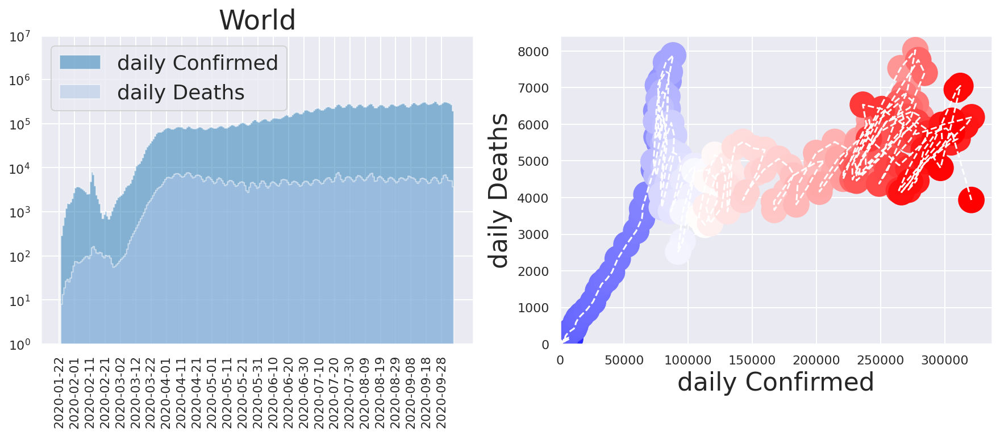

In [28]:
skip=10
figure(figsize=(15,5))

subplot(121)
yy=world_tot
# plot(yy.Date,yy.Confirmed,label='Confirmed',linewidth=3)
fill_between(yy.Date,yy.Confirmed.rolling(7,
    win_type='gaussian',
    min_periods=1,
    center=True).mean(std=1).diff(),alpha=0.5,step="pre",label='daily Confirmed')

# plot(yy.Date,yy.Deaths,label='Deaths',linewidth=3)
fill_between(yy.Date,yy.Deaths.rolling(7,
    win_type='gaussian',
    min_periods=1,
    center=True).mean(std=1).diff(),alpha=0.5,step="pre",label='daily Deaths')
title('World',fontsize=24)
xticks(rotation=90)
yscale('log')
gca().set_ylim(bottom=1,top=10**7)
gca().set_xticks(yy.Date[::skip]);
gca().set_xticklabels(yy.Date.values.astype('datetime64[D]')[::skip]);
# ylim([0,20000])
# gca().set_xticklabels(yy.Date.WeekdayLocator()[::skip]);
# gca().xaxis.set_major_locator(yy.Date.WeekdayLocator())
# gca().xaxis.set_major_formatter(yy.Date.DateFormatter('%b %d'))
legend(fontsize=18,loc=2)

subplot(122)
plot(yy.Confirmed.diff().rolling(7,
    win_type='gaussian',
    min_periods=1,
    center=True).mean(std=1),yy.Deaths.rolling(3,
    win_type='gaussian',
    min_periods=1,
    center=True).mean(std=1).diff(),'w--')

scatter(yy.Confirmed.diff().rolling(7,
    win_type='gaussian',
    min_periods=1,
    center=True).mean(std=1),yy.Deaths.rolling(3,
    win_type='gaussian',
    min_periods=1,
    center=True).mean(std=1).diff(),c=range(len(yy.Deaths.diff())), cmap='bwr',s=500)
xlabel('daily Confirmed',fontsize=22)
ylabel('daily Deaths',fontsize=22)
gca().set_ylim(bottom=0)
gca().set_xlim(left=0)
#tight_layout()

[[Model]]
    Model(gompertz_model)
[[Fit Statistics]]
    # fitting method   = leastsq
    # function evals   = 52
    # data points      = 259
    # variables        = 3
    chi-square         = 1.5966e+13
    reduced chi-square = 6.2366e+10
    Akaike info crit   = 6440.76079
    Bayesian info crit = 6451.43127
[[Variables]]
    a:  133.563279 +/- 1.69835338 (1.27%) (init = 1)
    b:  7.62289101 +/- 0.04470091 (0.59%) (init = 10)
    c:  1.0803e+08 +/- 2462947.66 (2.28%) (init = 1e+08)
[[Correlations]] (unreported correlations are < 0.100)
    C(a, c) =  0.985
    C(a, b) = -0.900
    C(b, c) = -0.813
[[Model]]
    Model(gompertz_model)
[[Fit Statistics]]
    # fitting method   = leastsq
    # function evals   = 52
    # data points      = 259
    # variables        = 3
    chi-square         = 1.5966e+13
    reduced chi-square = 6.2366e+10
    Akaike info crit   = 6440.76079
    Bayesian info crit = 6451.43127
[[Variables]]
    a:  133.563279 +/- 1.69835338 (1.27%) (init = 1)
    b

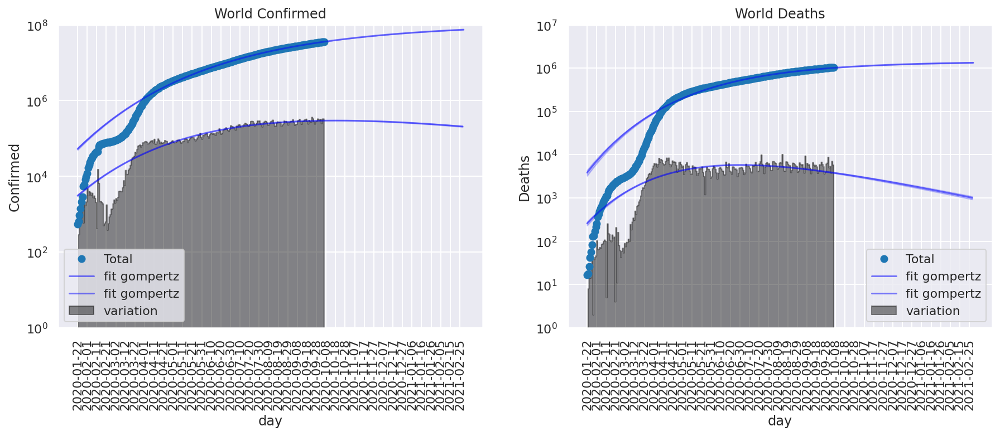

In [29]:
var='Confirmed'
# var='Deaths'


drange=pd.date_range(start="2020-01-22",end="2021-03-01")
drange=array(drange.format(formatter=lambda x: x.strftime('%Y-%m-%d')))
LL=len(drange)
skip=10



dd=world_tot
aa=0
cc=0
yy=var
if cc>0:
    yyy=dd[yy][aa:-cc]
    xx=arange(len(dd))[aa:-cc]
elif cc==0:
    yyy=dd[yy][aa:]
    xx=arange(len(dd))[aa:]

model1 = StepModel(form='logistic')
params1 = model1.guess(yyy, x=xx)

model2 = Model(gompertz_model)
params2 = model2.make_params(a=1, b=10, c=100000000)

# model2 = Model(double_gompertz)
# params2 = model2.make_params(a1=10, b1=1, a2=30, b2=100, c1=10000000, c2=10000000)


result1 = model1.fit(yyy, params1, x=xx)
result2 = model2.fit(yyy, params2, x=xx)

print(result2.fit_report())


figure(figsize=(15,5))
# result.plot_fit()
subplot(121)
title('World total '+var)
plot(xx,yyy,'o',label='Total')
# plot(xx,yyy/0.01,'o',label='Estimated contagion')

xp=arange(LL)

dely1 = result1.eval_uncertainty(x=xp,sigma=1)
dely2 = result2.eval_uncertainty(x=xp,sigma=1)



# plot((result1.eval(x=xp)),label='fit logistic',color='red',alpha=0.5)
plot((result2.eval(x=xp)),label='fit gompertz',color='blue',alpha=0.5)

# fill_between(xp, (result1.eval(x=xp)-dely1), (result1.eval(x=xp)+dely1), color="red",alpha=0.2)
fill_between(xp, (result2.eval(x=xp)-dely2), (result2.eval(x=xp)+dely2), color="blue",alpha=0.2)

gca().set_xticks(xp[::4]);
# gca().set_xticklabels(dd.Date[dd.index]);
gca().set_xticklabels(xp[::4]);
# gca().get_yaxis().set_major_formatter(matplotlib.ticker.ScalarFormatter())
xticks(rotation=90);
xlabel('day')
ylabel(yy)
legend()
# yscale('log')
# gca().set_ylim(bottom=1000,top=10000000)

title('World '+var)
fill_between(xx,zeros_like(xx),yyy.diff(),label='variation',alpha=0.5,step="pre",color='k')
# plot(diff(result1.eval(x=xp)),label='fit logistic',color='red',alpha=0.5)
plot(diff(result2.eval(x=xp)),label='fit gompertz',color='blue',alpha=0.5)

# fill_between(xp[:-1], diff(result1.eval(x=xp)-dely1), diff(result1.eval(x=xp)+dely1), color="red",alpha=0.2)
fill_between(xp[:-1], diff(result2.eval(x=xp)-dely2), diff(result2.eval(x=xp)+dely2), color="blue",alpha=0.2)


gca().set_xticks(xp[::skip]);
gca().set_xticklabels(drange[::skip]);
#     gca().set_xticklabels(xp[::4]);
gca().get_yaxis().set_major_formatter(matplotlib.ticker.ScalarFormatter())
xticks(rotation=90);
xlabel('day')
ylabel(yy)

yscale('log')
gca().set_ylim(bottom=1,top=10**8)

# ylim([1,1000000])
legend()
# show()

print(result2.fit_report())


# plot(dd.Date,dd[var],'.-',label=ss)

##################

var='Deaths'

dd=world_tot
aa=0
cc=0
yy=var
if cc>0:
    yyy=dd[yy][aa:-cc]
    xx=arange(len(dd))[aa:-cc]
elif cc==0:
    yyy=dd[yy][aa:]
    xx=arange(len(dd))[aa:]

model1 = StepModel(form='logistic')
params1 = model1.guess(yyy, x=xx)

model2 = Model(gompertz_model)
params2 = model2.make_params(a=1, b=10, c=100000000)


result1 = model1.fit(yyy, params1, x=xx)
result2 = model2.fit(yyy, params2, x=xx)


# result.plot_fit()
subplot(122)
title('World total '+var)
plot(xx,yyy,'o',label='Total')
# plot(xx,yyy/0.01,'o',label='Estimated contagion')


dely1 = result1.eval_uncertainty(x=xp,sigma=1)
dely2 = result2.eval_uncertainty(x=xp,sigma=1)



# plot((result1.eval(x=xp)),label='fit logistic',color='red',alpha=0.5)
plot((result2.eval(x=xp)),label='fit gompertz',color='blue',alpha=0.5)

# fill_between(xp, (result1.eval(x=xp)-dely1), (result1.eval(x=xp)+dely1), color="red",alpha=0.2)
fill_between(xp, (result2.eval(x=xp)-dely2), (result2.eval(x=xp)+dely2), color="blue",alpha=0.2)

gca().set_xticks(xp[::4]);
# gca().set_xticklabels(dd.Date[dd.index]);
gca().set_xticklabels(xp[::4]);
# gca().get_yaxis().set_major_formatter(matplotlib.ticker.ScalarFormatter())
xticks(rotation=90);
xlabel('day')
ylabel(yy)
legend()
# yscale('log')
# gca().set_ylim(bottom=1000,top=10000000)

title('World '+var)
fill_between(xx,zeros_like(xx),yyy.diff(),label='variation',alpha=0.5,step="pre",color='k')
# plot(diff(result1.eval(x=xp)),label='fit logistic',color='red',alpha=0.5)
plot(diff(result2.eval(x=xp)),label='fit gompertz',color='blue',alpha=0.5)

# fill_between(xp[:-1], diff(result1.eval(x=xp)-dely1), diff(result1.eval(x=xp)+dely1), color="red",alpha=0.2)
fill_between(xp[:-1], diff(result2.eval(x=xp)-dely2), diff(result2.eval(x=xp)+dely2), color="blue",alpha=0.2)


gca().set_xticks(xp[::skip]);
gca().set_xticklabels(drange[::skip]);
#     gca().set_xticklabels(xp[::4]);
gca().get_yaxis().set_major_formatter(matplotlib.ticker.ScalarFormatter())
xticks(rotation=90);
xlabel('day')
ylabel(yy)

yscale('log')
gca().set_ylim(bottom=1,top=10**7)

# ylim([1,1000000])
legend()
print(result2.fit_report())


(0.001, 1)

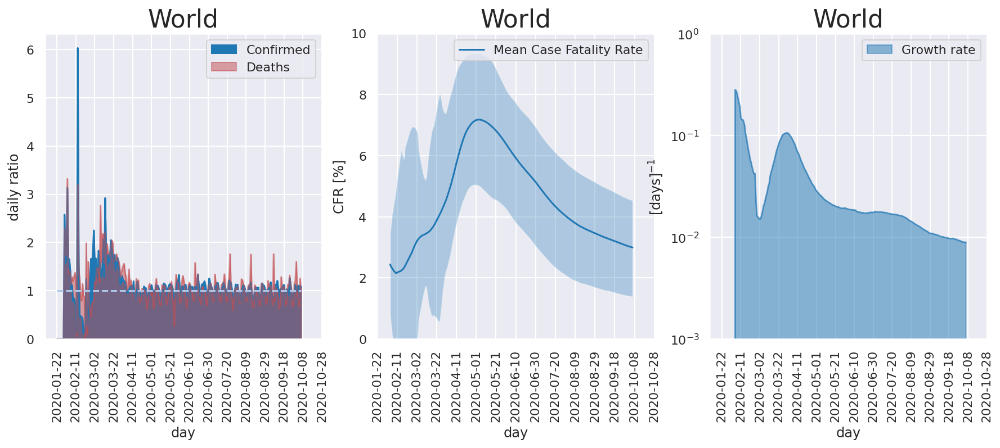

In [30]:
LL=300

figure(figsize=(15,5))
subplot(131)
title('World',fontsize=22)
(world_tot.Confirmed.diff()/world_tot.Confirmed.diff().shift(periods=1).rolling(7).mean()).plot.area(alpha=1)
(world_tot.Deaths.diff()/world_tot.Deaths.diff().shift(periods=1).rolling(7).mean()).plot.area(alpha=0.5,color='r')
plot(ones_like(world_tot.Confirmed.diff()),'--')
legend()
skip=20
gca().set_xticks(xp[:LL][::skip]);
gca().set_xticklabels(drange[:LL][::skip]);
xticks(rotation=90);
xlabel('day')
ylabel('daily ratio')


subplot(132)
title('World',fontsize=22)
plot(world_tot['Estimated Fatality mean'].rolling(14).mean(),label='Mean Case Fatality Rate')
fill_between(arange(len(world_tot)),
             world_tot['Estimated Fatality mean'].rolling(7).mean()-world_tot['Estimated Fatality'].rolling(14).mean()/2,
             world_tot['Estimated Fatality mean'].rolling(7).mean()+world_tot['Estimated Fatality'].rolling(14).mean()/2,
             alpha=0.3)
# (1/(world_tot.Confirmed.diff()/world_tot.Confirmed.shift(periods=1).rolling(14).mean())).plot.area(alpha=1)

legend()
# skip=20
gca().set_xticks(xp[:LL][::skip]);
gca().set_xticklabels(drange[:LL][::skip]);
xticks(rotation=90);
xlabel('day')
ylabel('CFR [%]')
# yscale('log')
ylim([0,10])

subplot(133)
title('World',fontsize=22)
# (100*world_tot.Deaths/world_tot.Confirmed.rolling(14).mean()).plot.area(label='CFR',alpha=0.5,ax=plt.gca())
(log(world_tot.Confirmed).diff().rolling(14).mean()).plot.area(alpha=0.5,label='Growth rate')

legend()
# skip=10
gca().set_xticks(xp[:LL][::skip]);
gca().set_xticklabels(drange[:LL][::skip]);
xticks(rotation=90);
xlabel('day')
ylabel('[days]$^{-1}$')
yscale('log')
gca().set_ylim(bottom=0.001,top=1)


No handles with labels found to put in legend.
No handles with labels found to put in legend.


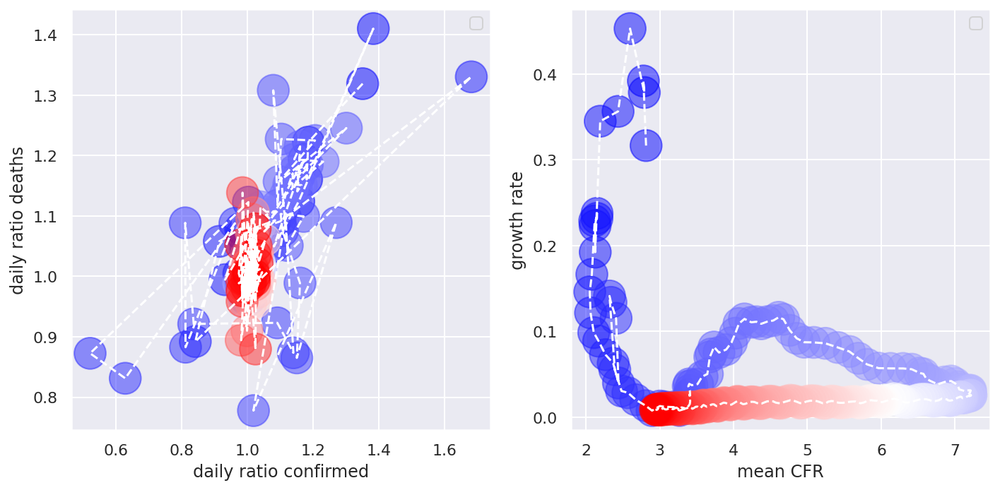

In [31]:
figure(figsize=(10,5))
subplot(121)
xx=(world_tot.Confirmed.diff().rolling(7).mean(std=3)/world_tot.Confirmed.diff().shift(periods=1).rolling(7).mean(std=3))
yy=(world_tot.Deaths.diff().rolling(7).mean(std=3)/world_tot.Deaths.diff().shift(periods=1).rolling(7).mean(std=3))

plot(xx,yy,'w--')
scatter(xx,yy,c=range(len(xx)),cmap='bwr',s=500,alpha=0.5)
legend()
skip=20
xlabel('daily ratio confirmed')
ylabel('daily ratio deaths')

subplot(122)
xx=world_tot['Estimated Fatality mean'].rolling(3).mean(std=3)
yy=(log(world_tot.Confirmed).diff().rolling(3).mean(std=3))
plot(xx,yy,'w--')
scatter(xx,yy,c=range(len(xx)),cmap='bwr',s=500,alpha=0.5)
legend()
skip=20
ylabel('growth rate')
xlabel('mean CFR')
tight_layout()

# $R_t$ Italia

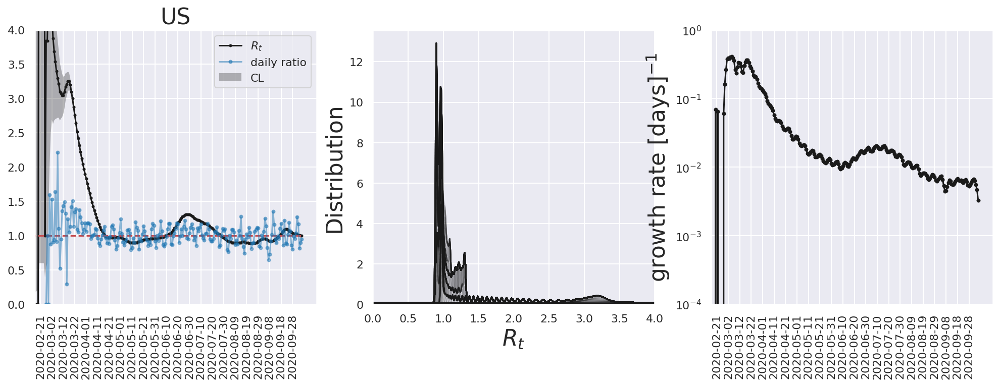

In [32]:
# reg='ITALY'
# k=ita.totale_casi.diff().rolling(2,
#         win_type='gaussian',
#         min_periods=1,
#         center=True).mean(std=2).round()

start=25
skip=10

reg='US'
dd=world[world['Country/Region']==reg]
# dd=world_tot
k=dd.Confirmed.diff().rolling(14,
        win_type='gaussian',
        min_periods=1,
        center=True).mean(std=3).round()

posteriors = get_posteriors(k,window=14,min_periods=1)

# Note that this takes a while to execute - it's not the most efficient algorithm
hdi = highest_density_interval(posteriors, p=0.95)

most_likely = posteriors.idxmax()

# Look into why you shift -1
# result = pd.concat([most_likely, hdi], axis=1)


figure(figsize=(17,5))

subplot(131)
most_likely.plot(marker='.',
                label='$R_t$',
                c='k',
                markersize=4)
plot(most_likely.index,ones_like(k),'r--')
fill_between(most_likely.index,
             hdi['Low'],
             hdi['High'],
             color='k',
             alpha=.3,
             lw=0,
             label='CL')

(dd.Confirmed.diff()/dd.Confirmed.diff().shift(periods=1).rolling(10,
    win_type='gaussian',
    min_periods=1,
    center=True).mean(std=4).round()).plot(style='.-',alpha=0.5,label='daily ratio')

legend()
title(reg,fontsize=22)
ylim([0,4])
gca().set_xticks(most_likely.index[::skip]);
# gca().set_xticklabels(data[data.index][::2]);
gca().set_xticklabels(dd.Date.dt.date[::skip]);
xticks(rotation=90);
# ylabel('$R_t$',fontsize=22)
gca().set_xlim(left=most_likely.index[start])


subplot(132)

posteriors.plot.area(color='k',legend='',xlim=[0,4],alpha=0.1,ax=plt.gca())
xlabel('$R_t$',fontsize=22)
ylabel('Distribution',fontsize=22)

subplot(133)
# yyy=(dd.Confirmed.diff()/dd.Confirmed.shift(periods=1).rolling(7,
#     win_type='gaussian',
#     min_periods=1,
#     center=True).mean(std=3).round())
yyy=(log(dd.Confirmed.rolling(7,
    win_type='gaussian',
    min_periods=1,
    center=True).mean(std=1).round()).diff())

(yyy).plot(style='k.-',ax=plt.gca())
gca().set_xticks(dd.index[::skip]);
gca().set_xticklabels(dd.Date.dt.date[::skip]);
xticks(rotation=90);
ylabel('growth rate [days]$^{-1}$',fontsize=22)
gca().set_ylim(bottom=0.0001,top=1)
gca().set_xlim(left=yyy.index[start])
yscale('log')